In [1]:
import os
import anndata as ad
import scipy as sp
import pickle
import pandas as pd
import igraph as ig
import seaborn as sb
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.patches import Patch

In [2]:
data = os.path.abspath(os.path.join(os.getcwd(),"../data"))

input = os.path.join(data, "input")
output = os.path.join(data, "output")
core_P = os.path.join(output, "core_P")
plots = os.path.join(output, "plots")
tables = os.path.join(output, "tables")

In [3]:
with open(os.path.join(core_P, "patient_disease_map_core.pickle"), "rb") as f:
    patient_disease_map = pickle.load(f) 

with open(os.path.join(core_P, "patient_disease_map_core_reduced.pickle"), "rb") as f:
    patient_disease_map_reduced = pickle.load(f) 

with open(os.path.join(core_P, "disease_patient_map_core.pickle"), "rb") as f:
    disease_patient_map = pickle.load(f) 

with open(os.path.join(core_P, "disease_patient_map_core_reduced.pickle"), "rb") as f:
    disease_patient_map_reduced = pickle.load(f) 

In [4]:
# Read Shared Data 
with open(os.path.join(core_P, "num_patients.pickle"), "rb") as f:
    id_to_num_patients = pickle.load(f)

with open(os.path.join(core_P, "patient_disease_map_core.pickle"), "rb") as f:
    patient_disease_map = pickle.load(f) 

with open(os.path.join(core_P, "patient_disease_map_core_reduced.pickle"), "rb") as f:
    patient_disease_map_reduced = pickle.load(f) 

with open(os.path.join(core_P, "disease_patient_map_core.pickle"), "rb") as f:
    disease_patient_map = pickle.load(f) 

with open(os.path.join(core_P, "disease_patient_map_core_reduced.pickle"), "rb") as f:
    disease_patient_map_reduced = pickle.load(f) 

with open(os.path.join(core_P, "id_to_name.pickle"), "rb") as f:
    id_to_name = pickle.load(f)

with open(os.path.join(core_P, "name_to_id.pickle"), "rb") as f:
    name_to_id = pickle.load(f) 

with open(os.path.join(core_P, "id_to_pb.pickle"), "rb") as f:
    id_to_pb = pickle.load(f) 

with open(os.path.join(core_P, "id_to_5NN.pickle"), "rb") as f:
    id_to_5NN = pickle.load(f) 

with open(os.path.join(core_P, "id_to_graph_per_node_5.pickle"), "rb") as f:
    id_to_graph_per_node_5 = pickle.load(f) 


In [5]:
# 1 Facs, 1 Luminex, 4 ADT, 4 Cytof, 4 bulkRNA, 6 citeRNA
graphs_to_explore = ["G365",
                    "G364",
                    "G341", "G343", "G348", "G351",
                    "G363", "G360", "G358", "G355",
                    "G0", "G5", "G8", "G11",
                    "G12", "G50", "G85", "G102", "G200", "G300"]

## Overview

In [6]:
diseases = list(disease_patient_map.keys())
disease_groups = list(disease_patient_map_reduced.keys())

community_algs = ["edge_betweenness_high", "edge_betweenness_low", "eigen_vector_high", "eigen_vector_low", "walk_trap" ]

In [7]:
overview_df = {}
index = ["name", "mean degree", "min degree", "max degree", "density", "num vertices", "average path length"]
for g in graphs_to_explore:
    overview_df["5NN_" + g] = []
    overview_df["5NN_" + g].append(id_to_name[g])
    overview_df["5NN_" + g].append(np.mean(id_to_5NN[g].degree()))
    overview_df["5NN_" + g].append(np.min(id_to_5NN[g].degree()))
    overview_df["5NN_" + g].append(np.max(id_to_5NN[g].degree()))
    overview_df["5NN_" + g].append(id_to_5NN[g].density())
    overview_df["5NN_" + g].append(id_to_5NN[g].vcount())
    overview_df["5NN_" + g].append(id_to_5NN[g].average_path_length())

    overview_df["corr_" + g] = []
    overview_df["corr_" + g].append(id_to_name[g])
    overview_df["corr_" + g].append(np.mean(id_to_graph_per_node_5[g].degree()))
    overview_df["corr_" + g].append(np.min(id_to_graph_per_node_5[g].degree()))
    overview_df["corr_" + g].append(np.max(id_to_graph_per_node_5[g].degree()))
    overview_df["corr_" + g].append(id_to_graph_per_node_5[g].density())
    overview_df["corr_" + g].append(id_to_graph_per_node_5[g].vcount())
    overview_df["corr_" + g].append(id_to_graph_per_node_5[g].average_path_length())

pd.DataFrame(overview_df, index=index).to_csv(os.path.join(tables, "overview.xlsx"))

In [8]:
palette = ig.RainbowPalette(n=7)
disease_color_map = {diseases[i]:palette[i] for i in range(7)}
palette = ig.RainbowPalette(n=3)
disease_group_color_map = {disease_groups[i]:palette[i] for i in range(3)}

In [9]:
def visualized_d(ax, graph):
    vertex_colors = []
    edge_colors = []

    for v in graph.vs:
        vertex_colors.append(disease_color_map[v["disease"]])

    for e in graph.es:
        s_d = graph.vs[e.source]["disease"]
        t_d = graph.vs[e.target]["disease"]
        if s_d == t_d:
            edge_colors.append(disease_color_map[s_d])
        else:
            edge_colors.append("#000000")

    
    ig.plot(
        graph,
        vertex_color = vertex_colors ,
        edge_color = edge_colors ,
        edge_width=1,
        target=ax,
        vertex_size=0.3,
    )

In [10]:
def visualized_dg(ax, graph):
    vertex_colors = []
    edge_colors = []
    
    for v in graph.vs:
        vertex_colors.append(disease_group_color_map[v["disease_group"]])
    
    for e in graph.es:
        s_d = graph.vs[e.source]["disease_group"]
        t_d = graph.vs[e.target]["disease_group"]
        if s_d == t_d:
            edge_colors.append(disease_group_color_map[s_d])
        else:
            edge_colors.append("#000000")

    ig.plot(
        graph,
        vertex_color = vertex_colors ,
        edge_color = edge_colors ,
        edge_width=1,
        target=ax,
        vertex_size=0.3,
    )

In [11]:
palette = ig.RainbowPalette(n=15)

def visualized_com(communities, ax, alg, graph):
    if alg == "edge_betweenness_high" or alg == "edge_betweenness_low" or alg == "fast_greedy" or alg == "walk_trap":
        communities = communities.as_clustering()
        
    num_communities = len(communities)
    
    for i, community in enumerate(communities):
        graph.vs[community]["com_" + alg] = i
        community_edges = graph.es.select(_within=community)
        community_edges["color"] = i
    
    ig.plot(
        communities,
        palette=palette,
        edge_width=1,
        target=ax,
        vertex_size=0.3,
    )

    # Create a custom color legend
    legend_handles = []
    for i in range(num_communities):
        handle = ax.scatter(
            [], [],
            s=100,
            facecolor=palette.get(i),
            edgecolor="k",
            label=i,
        )
        legend_handles.append(handle)
        
    ax.legend(
        handles=legend_handles,
        title='Community:',
        bbox_to_anchor=(0, 1.0),
        bbox_transform=ax.transAxes,
    )
    return num_communities

In [12]:
g_5NN_summary = {}
g_corr_summary = {}

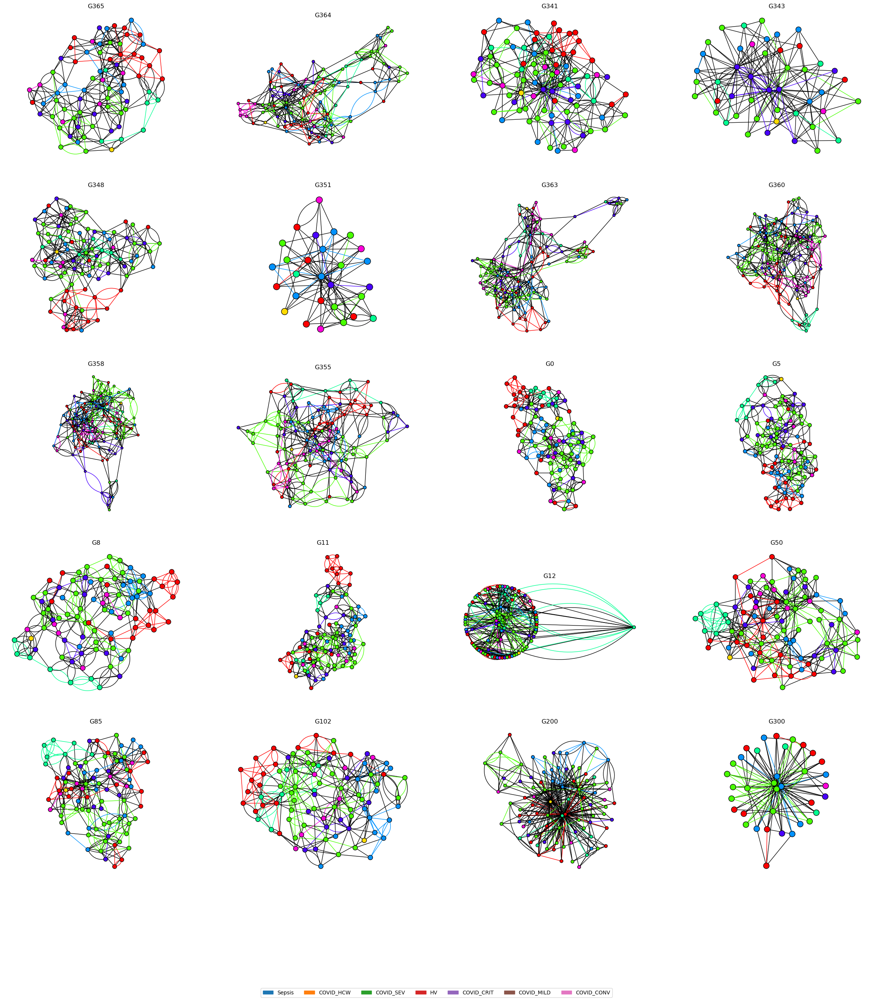

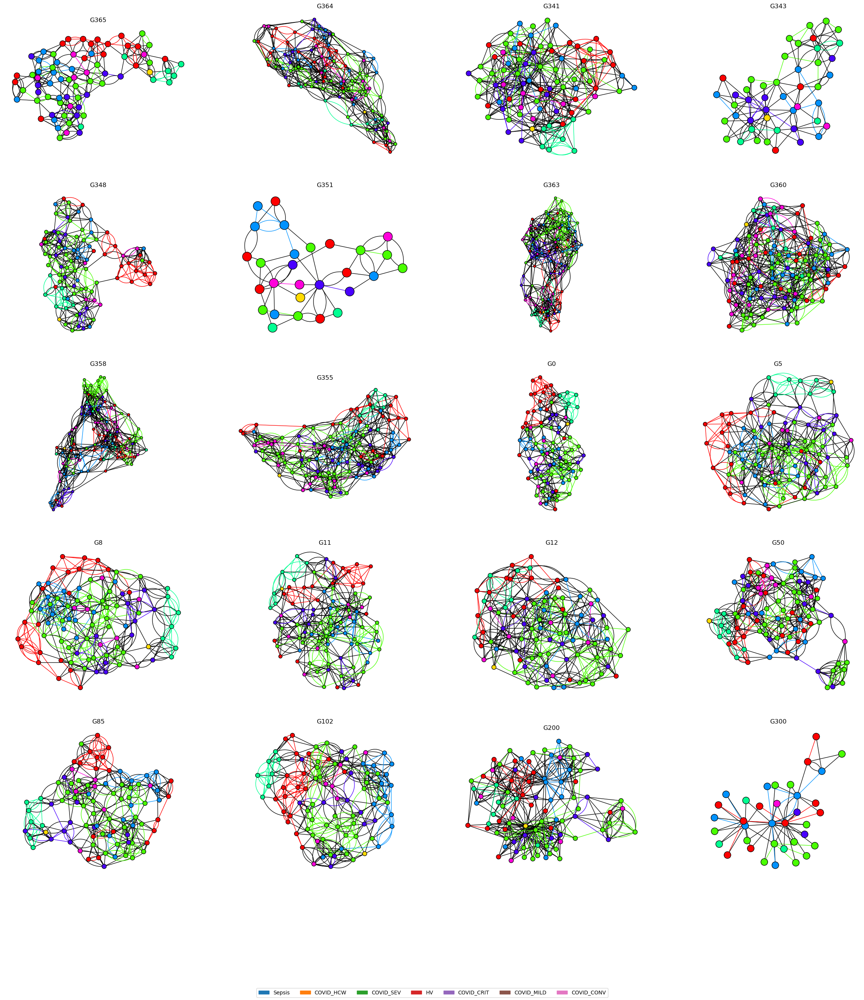

In [13]:
fig_5NN, ax_5NN = plt.subplots(5,4, figsize=(30,30))
fig_corr, ax_corr = plt.subplots(5,4, figsize=(30,30))
plot_pos = {"row": 0, "col": 0}


for count, graph_id in enumerate(graphs_to_explore):
    g_5NN = id_to_5NN[graph_id]
    g_corr = id_to_graph_per_node_5[graph_id]
    
    visualized_d(ax_5NN[plot_pos["row"], plot_pos["col"]], g_5NN)
    ax_5NN[plot_pos["row"], plot_pos["col"]].set_title(graph_id)

  
    visualized_d(ax_corr[plot_pos["row"], plot_pos["col"]], g_corr)
    ax_corr[plot_pos["row"], plot_pos["col"]].set_title(graph_id)
    
    #update position in plot
    plot_pos["col"] += 1
    if plot_pos["col"] == 4:
        plot_pos["col"] = 0 
        plot_pos["row"] += 1

         

# Get colours for current style
colours = plt.rcParams['axes.prop_cycle'].by_key()['color']
# Set up handles (the bits that are drawn in the legend) and labels
handles = []
group_labels = diseases
for group_idx in range(len(group_labels)):
    # Create a simple patch that is the correct colour
    colour = colours[group_idx]
    handles.append(Patch(edgecolor=colour, facecolor=colour, fill=True))
# Acutally create our figure legend, using the above handles and labels
loc='lower center'
ncol=len(group_labels)
fig_corr.legend(handles=handles, labels=group_labels, loc=loc, ncol=ncol)
fig_5NN.legend(handles=handles, labels=group_labels, loc=loc, ncol=ncol)

fig_5NN.savefig(os.path.join(plots, "5nn_d")) 
fig_corr.savefig(os.path.join(plots, "corr_d")) 

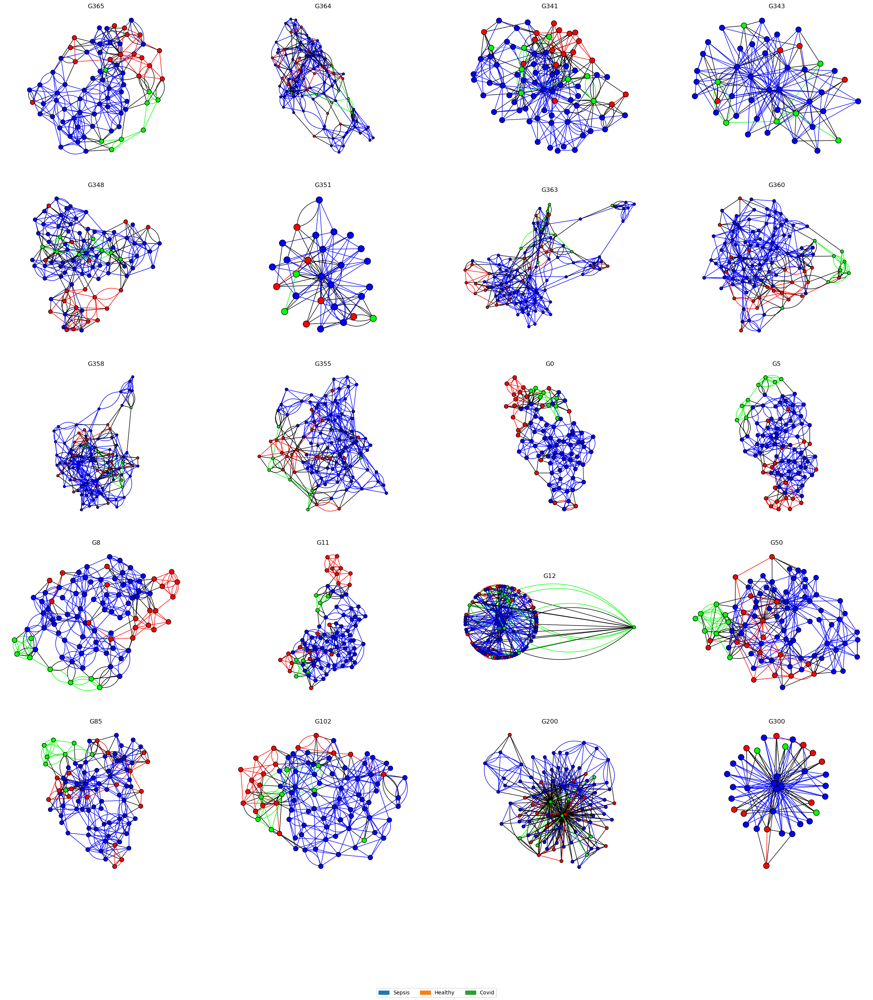

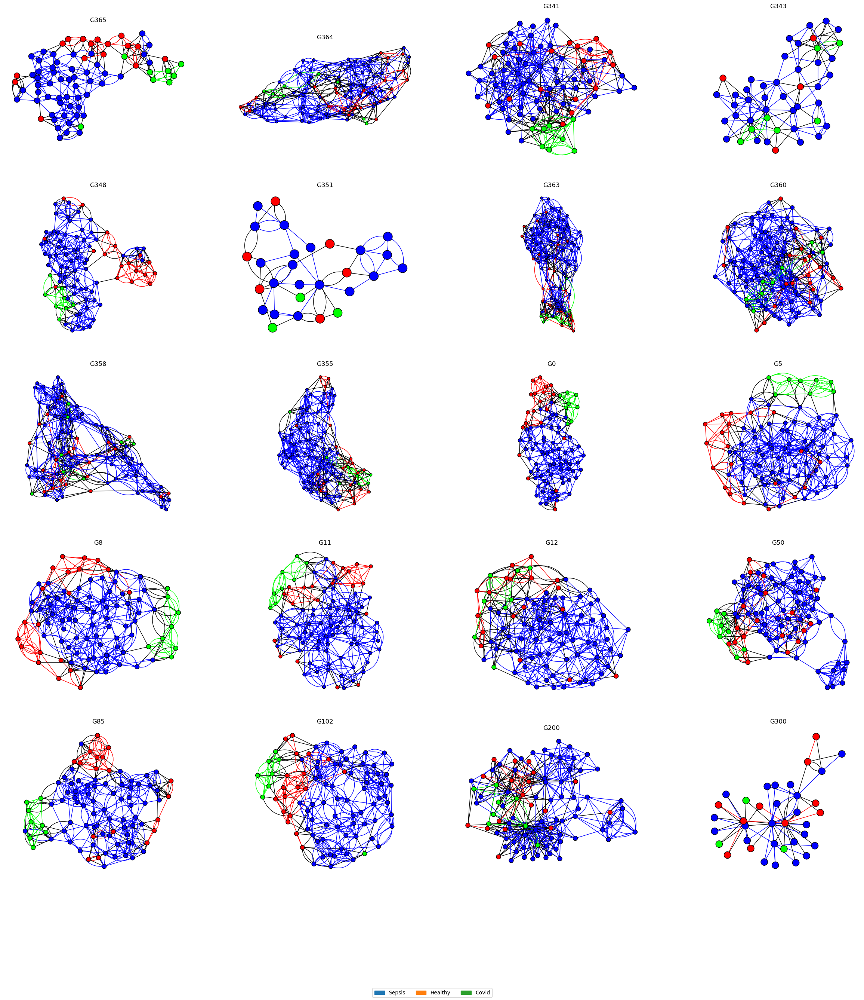

In [14]:
fig_5NN, ax_5NN = plt.subplots(5,4, figsize=(30,30))
fig_corr, ax_corr = plt.subplots(5,4, figsize=(30,30))
plot_pos = {"row": 0, "col": 0}


for count, graph_id in enumerate(graphs_to_explore):
    g_5NN = id_to_5NN[graph_id]
    g_corr = id_to_graph_per_node_5[graph_id]
    
    visualized_dg(ax_5NN[plot_pos["row"], plot_pos["col"]], g_5NN)
    ax_5NN[plot_pos["row"], plot_pos["col"]].set_title(graph_id)

  
    visualized_dg(ax_corr[plot_pos["row"], plot_pos["col"]], g_corr)
    ax_corr[plot_pos["row"], plot_pos["col"]].set_title(graph_id)
    
    #update position in plot
    plot_pos["col"] += 1
    if plot_pos["col"] == 4:
        plot_pos["col"] = 0 
        plot_pos["row"] += 1


# Get colours for current style
colours = plt.rcParams['axes.prop_cycle'].by_key()['color']
# Set up handles (the bits that are drawn in the legend) and labels
handles = []
group_labels = disease_groups
for group_idx in range(len(group_labels)):
    # Create a simple patch that is the correct colour
    colour = colours[group_idx]
    handles.append(Patch(edgecolor=colour, facecolor=colour, fill=True))
# Acutally create our figure legend, using the above handles and labels
loc='lower center'
ncol=len(group_labels)
fig_corr.legend(handles=handles, labels=group_labels, loc=loc, ncol=ncol)
fig_5NN.legend(handles=handles, labels=group_labels, loc=loc, ncol=ncol)


fig_5NN.savefig(os.path.join(plots, "5nn_dg")) 
fig_corr.savefig(os.path.join(plots, "corr_dg")) 

## Edge Betweenness High

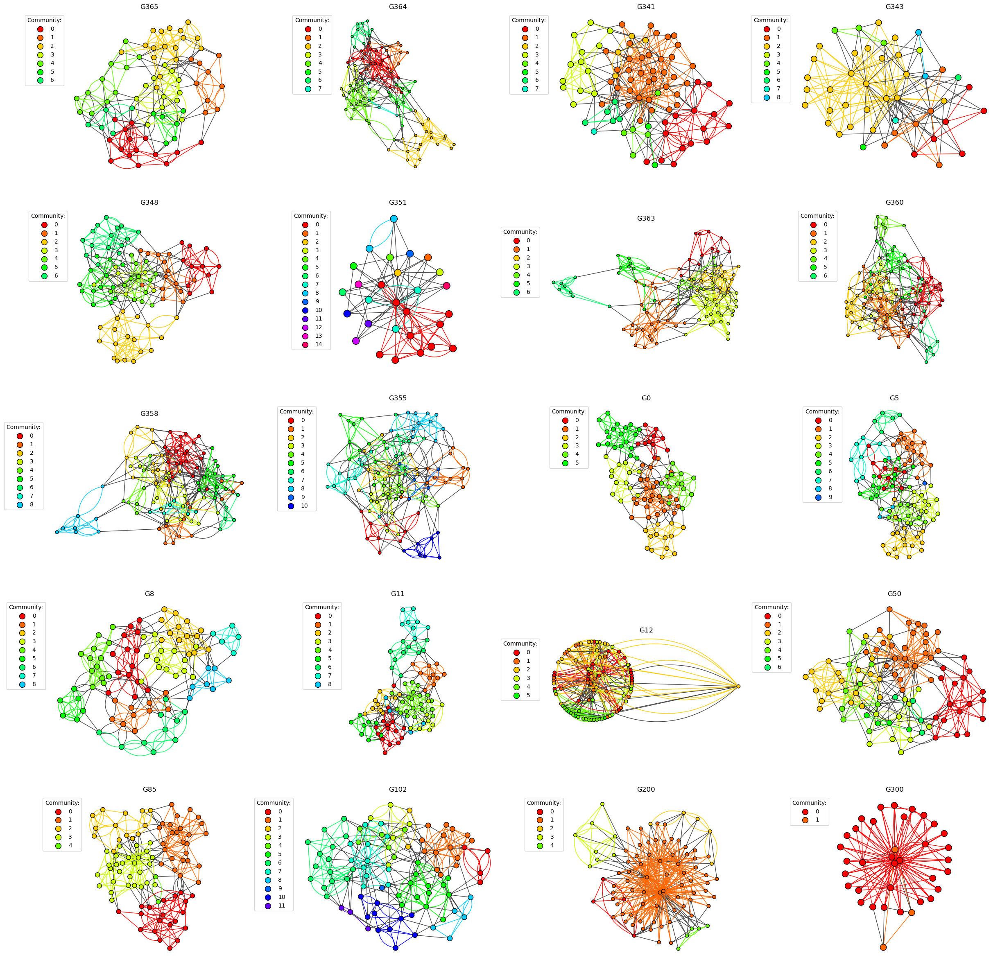

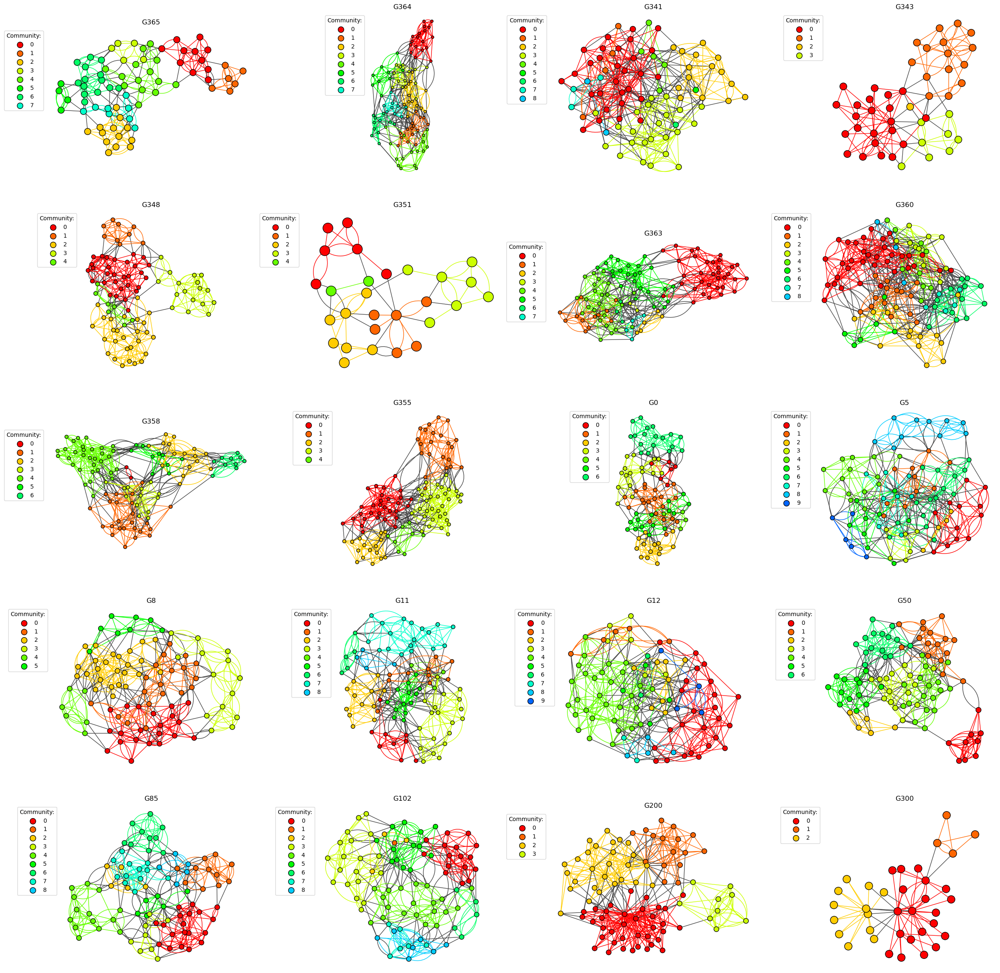

In [15]:
fig_5NN, ax_5NN = plt.subplots(5,4, figsize=(30,30))
fig_corr, ax_corr = plt.subplots(5,4, figsize=(30,30))
plot_pos = {"row": 0, "col": 0}
g_5NN_summary["edge_betweenness_high"]={}
g_corr_summary["edge_betweenness_high"]={}

for count, graph_id in enumerate(graphs_to_explore):
    g_5NN = id_to_5NN[graph_id]
    g_corr = id_to_graph_per_node_5[graph_id]

    communities_5NN = g_5NN.community_edge_betweenness(directed=False)
    num_com_5NN = visualized_com(communities_5NN, ax_5NN[plot_pos["row"], plot_pos["col"]], "edge_betweenness_high", g_5NN)
    ax_5NN[plot_pos["row"], plot_pos["col"]].set_title(graph_id)

    communities_corr = g_corr.community_edge_betweenness(directed= False)
    num_com_corr = visualized_com(communities_corr, ax_corr[plot_pos["row"], plot_pos["col"]], "edge_betweenness_high", g_corr)
    ax_corr[plot_pos["row"], plot_pos["col"]].set_title(graph_id)
    
    #update position in plot
    plot_pos["col"] += 1
    if plot_pos["col"] == 4:
        plot_pos["col"] = 0 
        plot_pos["row"] += 1
    
    g_5NN_summary["edge_betweenness_high"][graph_id] = {"num_com": num_com_5NN}
    g_corr_summary["edge_betweenness_high"][graph_id] = {"num_com": num_com_corr}

fig_5NN.savefig(os.path.join(plots, "5nn_edge_betweenness_high")) 
fig_corr.savefig(os.path.join(plots, "corr_edge_betweenness_high")) 
    

## Edge Betweenness Low

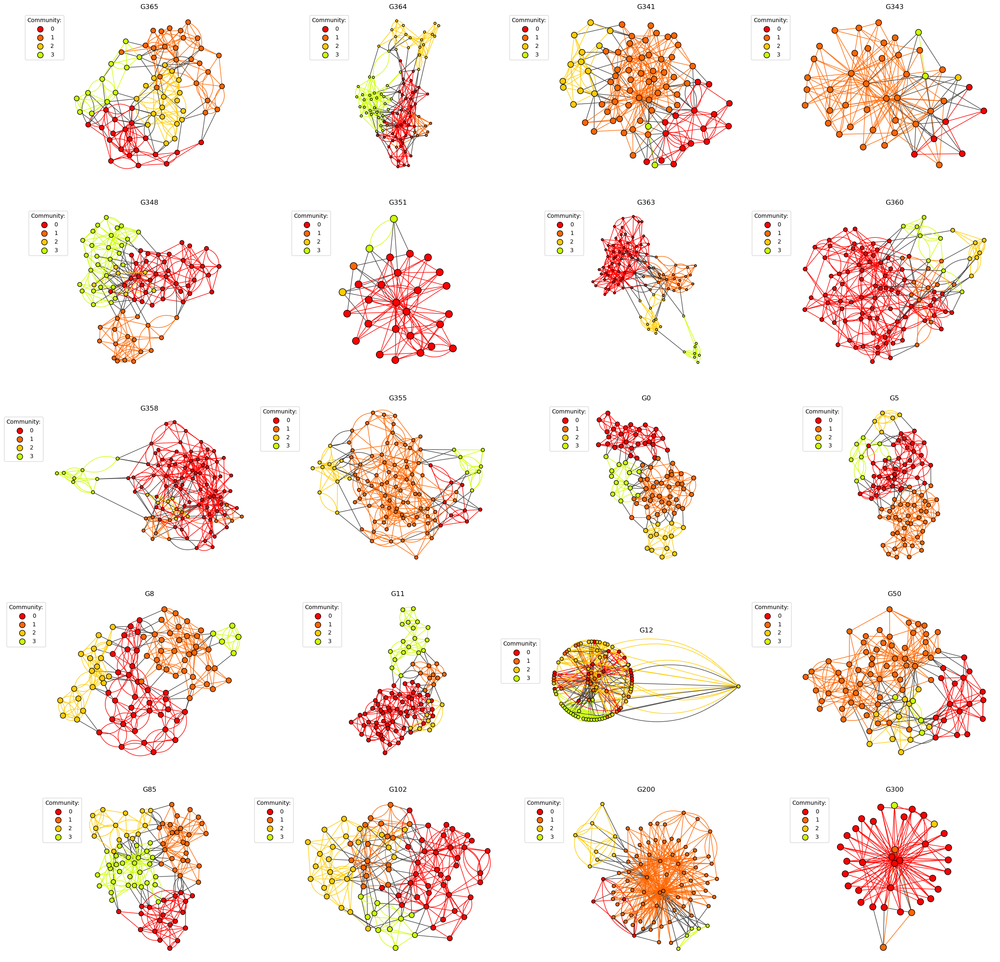

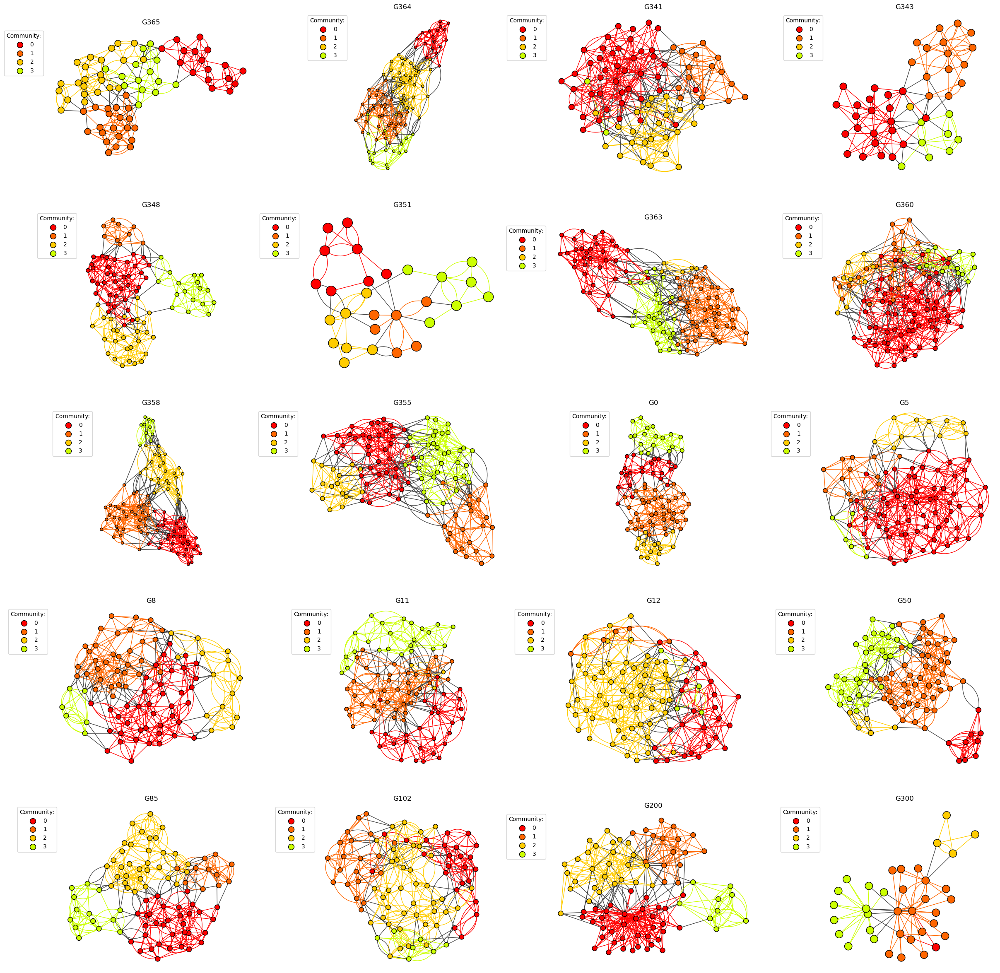

In [16]:
fig_5NN, ax_5NN = plt.subplots(5,4, figsize=(30,30))
fig_corr, ax_corr = plt.subplots(5,4, figsize=(30,30))
plot_pos = {"row": 0, "col": 0}
g_5NN_summary["edge_betweenness_low"]={}
g_corr_summary["edge_betweenness_low"]={}

for count, graph_id in enumerate(graphs_to_explore):
    g_5NN = id_to_5NN[graph_id]
    g_corr = id_to_graph_per_node_5[graph_id]

    communities_5NN = g_5NN.community_edge_betweenness(directed=False, clusters=4)
    num_com_5NN = visualized_com(communities_5NN, ax_5NN[plot_pos["row"], plot_pos["col"]], "edge_betweenness_low", g_5NN)
    ax_5NN[plot_pos["row"], plot_pos["col"]].set_title(graph_id)

    communities_corr = g_corr.community_edge_betweenness(directed= False, clusters=4)
    num_com_corr = visualized_com(communities_corr, ax_corr[plot_pos["row"], plot_pos["col"]], "edge_betweenness_low", g_corr)
    ax_corr[plot_pos["row"], plot_pos["col"]].set_title(graph_id)
    
    #update position in plot
    plot_pos["col"] += 1
    if plot_pos["col"] == 4:
        plot_pos["col"] = 0 
        plot_pos["row"] += 1
    
    g_5NN_summary["edge_betweenness_low"][graph_id] = {"num_com": num_com_5NN}
    g_corr_summary["edge_betweenness_low"][graph_id] = {"num_com": num_com_corr}

fig_5NN.savefig(os.path.join(plots, "5nn_edge_betweenness_low")) 
fig_corr.savefig(os.path.join(plots, "corr_edge_betweenness_low")) 

## Eigen Vector High

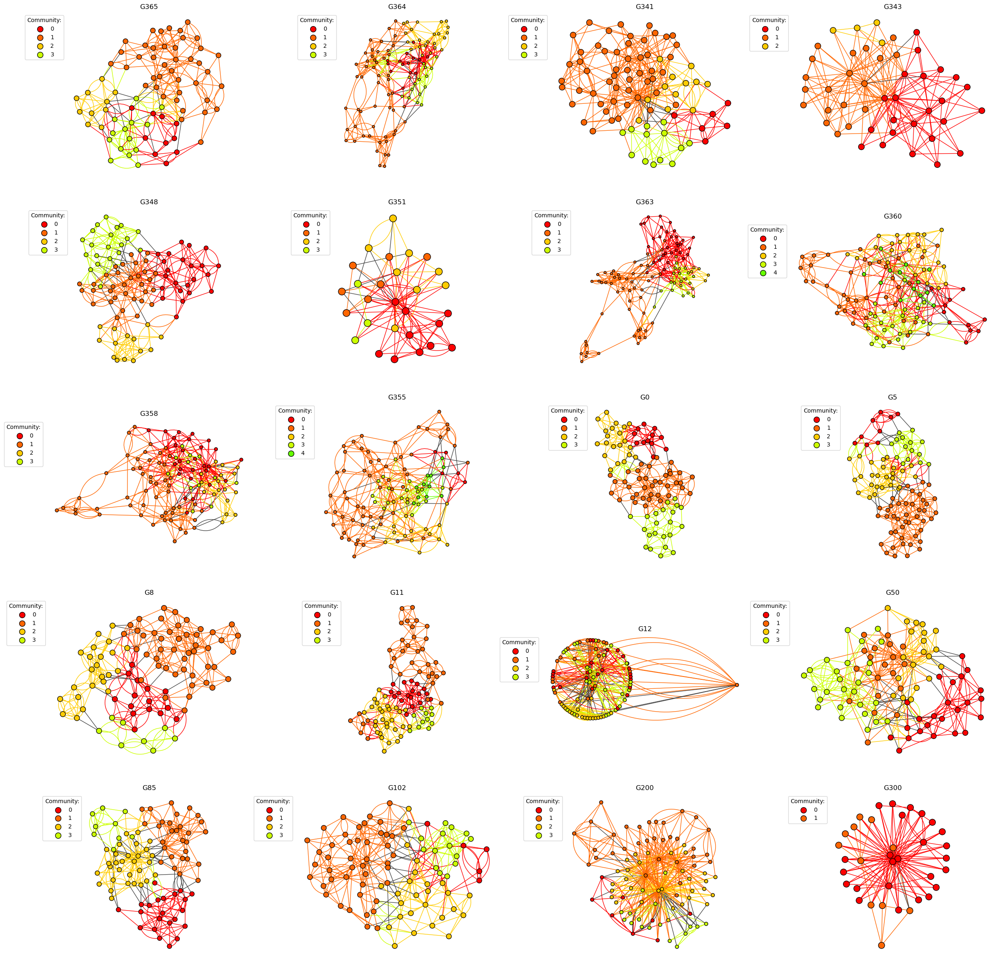

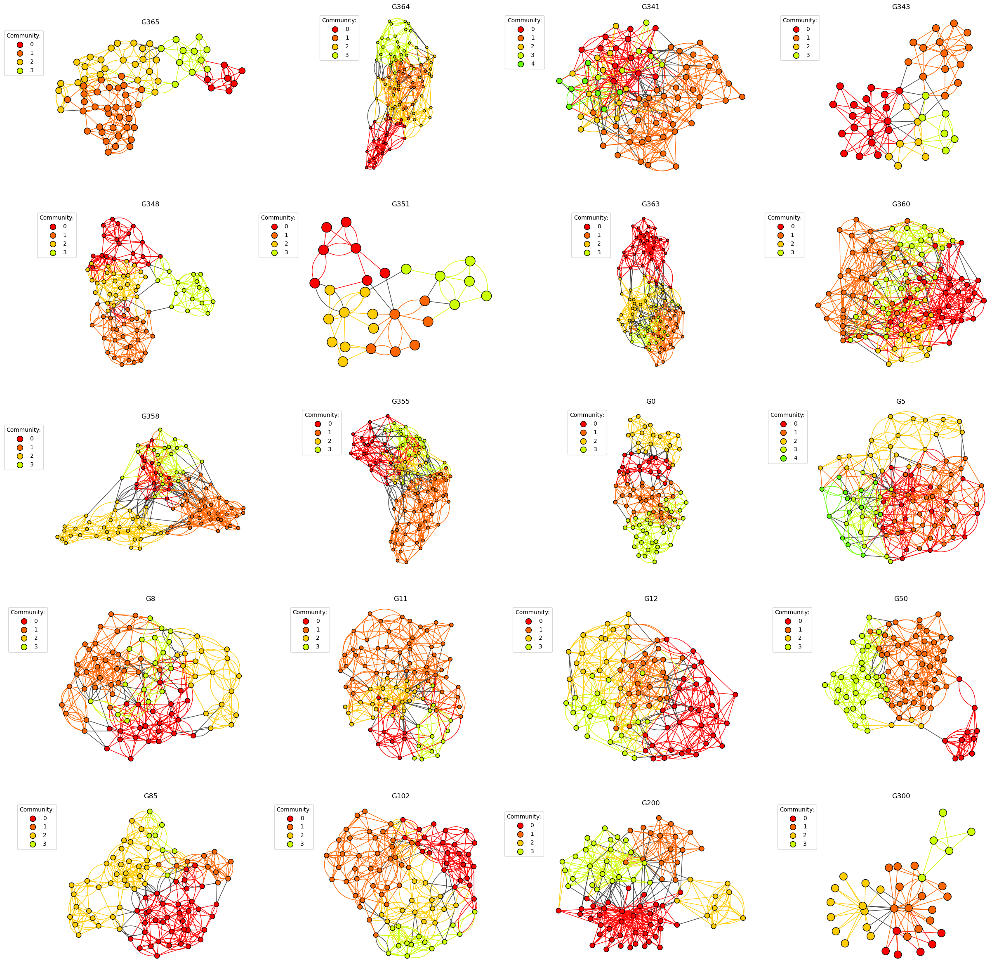

In [18]:
fig_5NN, ax_5NN = plt.subplots(5,4, figsize=(30,30))
fig_corr, ax_corr = plt.subplots(5,4, figsize=(30,30))
plot_pos = {"row": 0, "col": 0}
g_5NN_summary["eigen_vector_high"]={}
g_corr_summary["eigen_vector_high"]={}

for count, graph_id in enumerate(graphs_to_explore):
    g_5NN = id_to_5NN[graph_id]
    g_corr = id_to_graph_per_node_5[graph_id]
    
    communities_5NN = g_5NN.community_leading_eigenvector(clusters = 6)
    num_com_5NN = visualized_com(communities_5NN, ax_5NN[plot_pos["row"], plot_pos["col"]], "eigen_vector_high", g_5NN)
    ax_5NN[plot_pos["row"], plot_pos["col"]].set_title(graph_id)

    communities_corr = g_corr.community_leading_eigenvector(clusters = 6)
    num_com_corr = visualized_com(communities_corr, ax_corr[plot_pos["row"], plot_pos["col"]], "eigen_vector_high", g_corr)
    ax_corr[plot_pos["row"], plot_pos["col"]].set_title(graph_id)
    
    #update position in plot
    plot_pos["col"] += 1
    if plot_pos["col"] == 4:
        plot_pos["col"] = 0 
        plot_pos["row"] += 1

    g_5NN_summary["eigen_vector_high"][graph_id] = {"num_com":num_com_5NN}
    g_corr_summary["eigen_vector_high"][graph_id] = {"num_com":num_com_corr}

fig_5NN.savefig(os.path.join(plots, "5nn_eigen_vector_high")) 
fig_corr.savefig(os.path.join(plots, "corr_eigen_vector_high")) 


## Eigen Vector Low

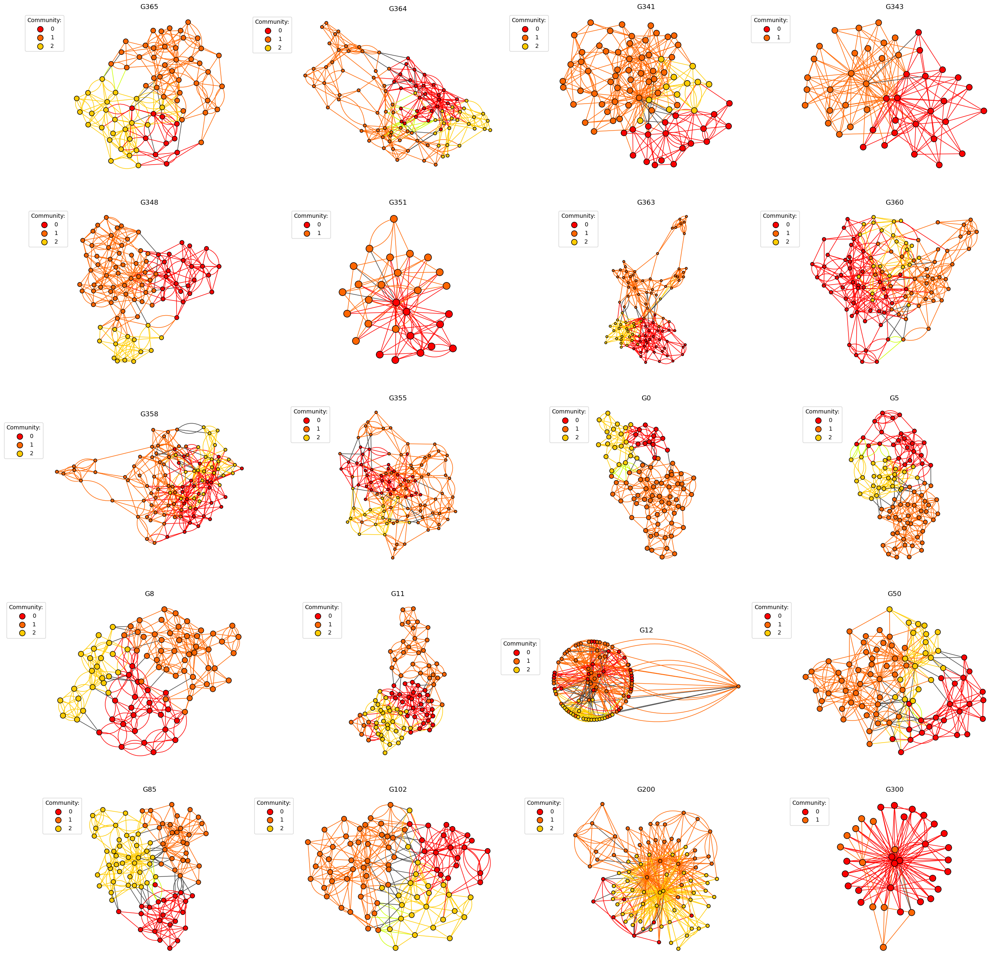

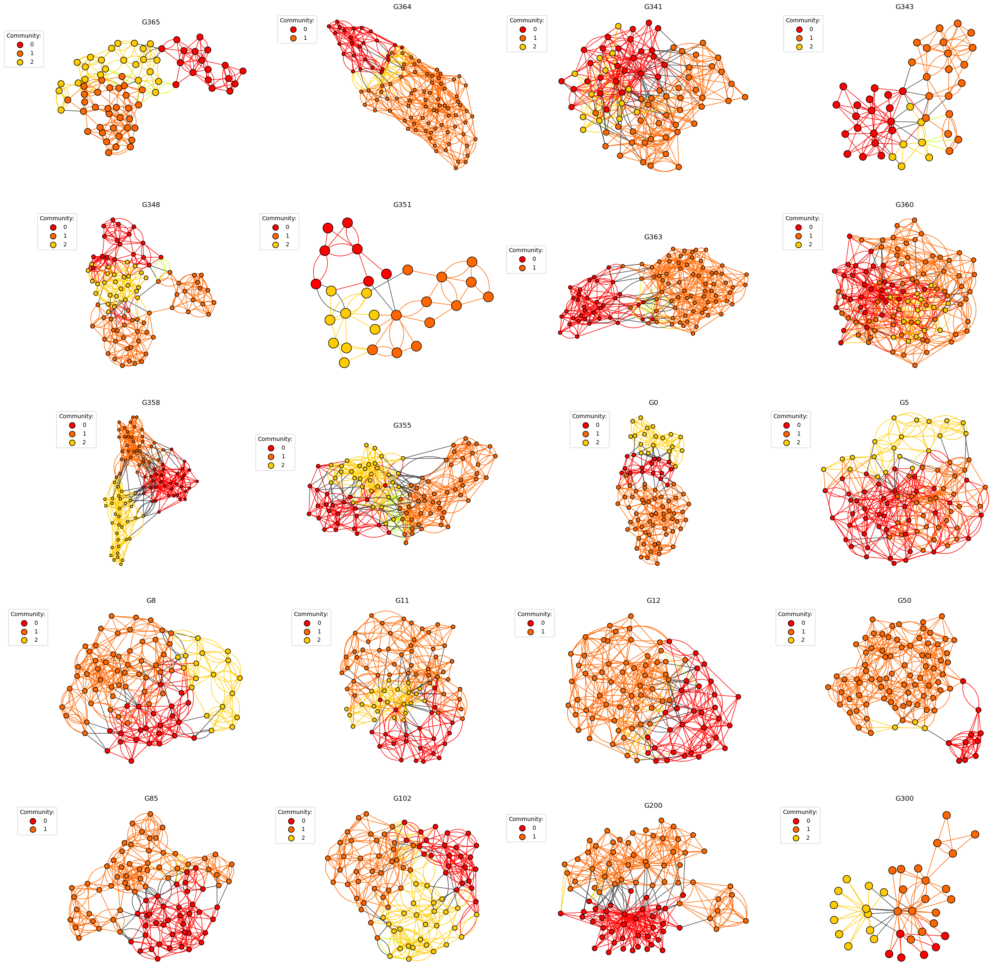

In [19]:
fig_5NN, ax_5NN = plt.subplots(5,4, figsize=(30,30))
fig_corr, ax_corr = plt.subplots(5,4, figsize=(30,30))
plot_pos = {"row": 0, "col": 0}
g_5NN_summary["eigen_vector_low"]={}
g_corr_summary["eigen_vector_low"]={}

for count, graph_id in enumerate(graphs_to_explore):
    g_5NN = id_to_5NN[graph_id]
    g_corr = id_to_graph_per_node_5[graph_id]
    
    communities_5NN = g_5NN.community_leading_eigenvector(clusters = 3)
    num_com_5NN = visualized_com(communities_5NN, ax_5NN[plot_pos["row"], plot_pos["col"]], "eigen_vector_low", g_5NN)
    ax_5NN[plot_pos["row"], plot_pos["col"]].set_title(graph_id)

    communities_corr = g_corr.community_leading_eigenvector(clusters = 3)
    num_com_corr = visualized_com(communities_corr, ax_corr[plot_pos["row"], plot_pos["col"]], "eigen_vector_low", g_corr)
    ax_corr[plot_pos["row"], plot_pos["col"]].set_title(graph_id)
    
    #update position in plot
    plot_pos["col"] += 1
    if plot_pos["col"] == 4:
        plot_pos["col"] = 0 
        plot_pos["row"] += 1

    g_5NN_summary["eigen_vector_low"][graph_id] = {"num_com":num_com_5NN}
    g_corr_summary["eigen_vector_low"][graph_id] = {"num_com":num_com_corr}

fig_5NN.savefig(os.path.join(plots, "5nn_eigen_vector_low")) 
fig_corr.savefig(os.path.join(plots, "corr_eigen_vector_low")) 


## Walk Trap

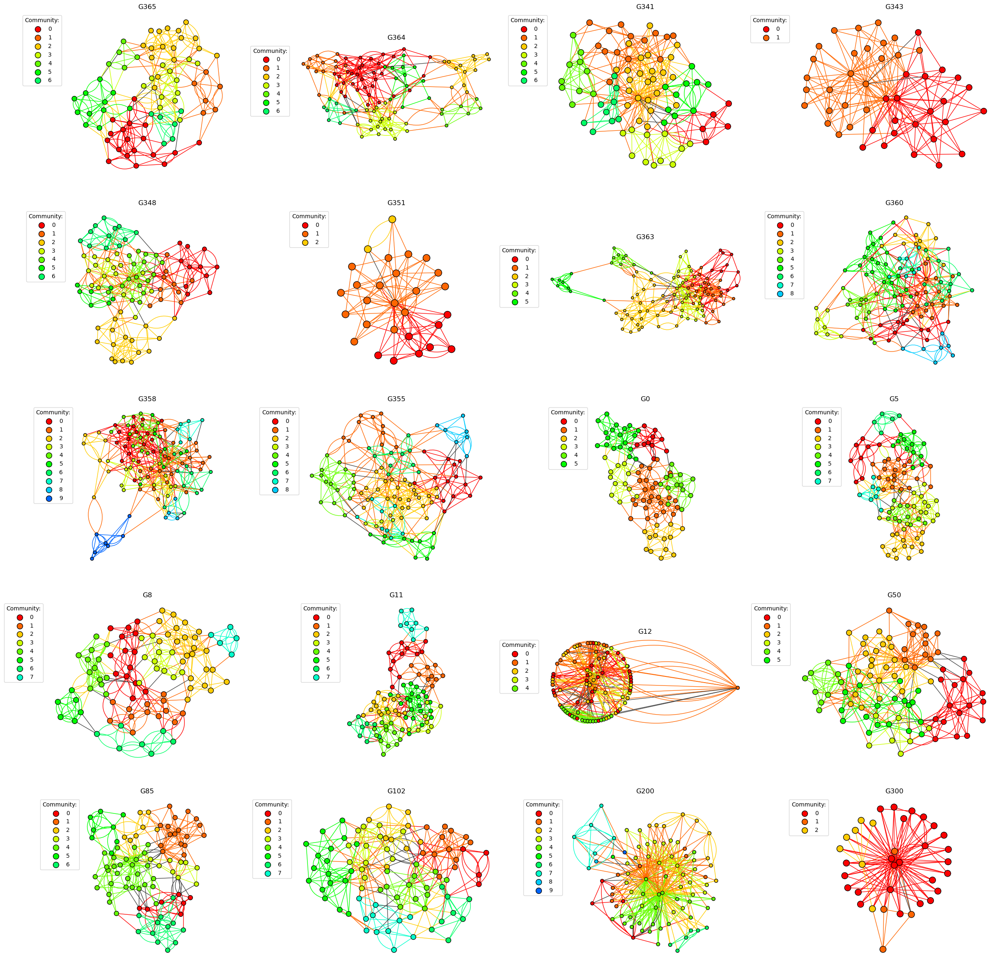

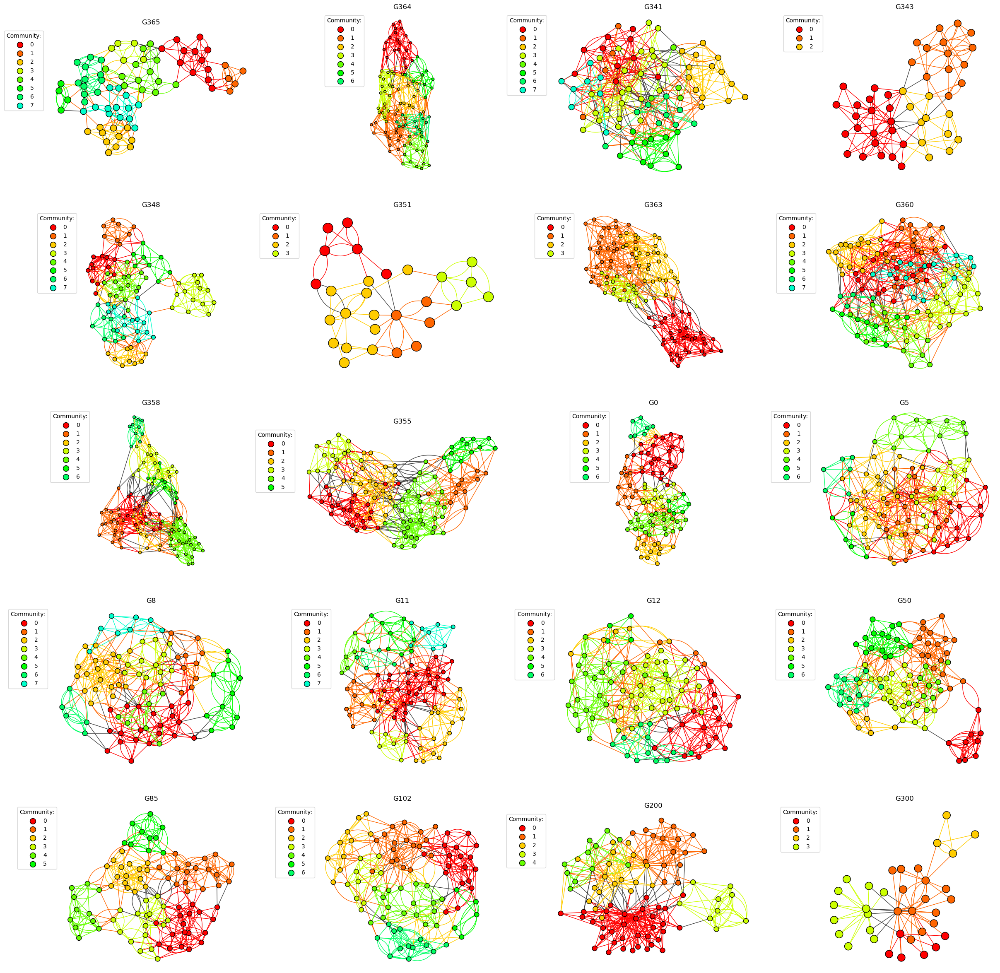

In [20]:
fig_5NN, ax_5NN = plt.subplots(5,4, figsize=(30,30))
fig_corr, ax_corr = plt.subplots(5,4, figsize=(30,30))
plot_pos = {"row": 0, "col": 0}
g_5NN_summary["walk_trap"]={}
g_corr_summary["walk_trap"]={}

for count, graph_id in enumerate(graphs_to_explore):
    g_5NN = id_to_5NN[graph_id]
    g_corr = id_to_graph_per_node_5[graph_id]
    
    communities_5NN = g_5NN.community_walktrap(steps = 4)
    num_com_5NN= visualized_com(communities_5NN, ax_5NN[plot_pos["row"], plot_pos["col"]], "walk_trap", g_5NN)
    ax_5NN[plot_pos["row"], plot_pos["col"]].set_title(graph_id)

    communities_corr = g_corr.community_walktrap(steps = 4)
    num_com_corr = visualized_com(communities_corr, ax_corr[plot_pos["row"], plot_pos["col"]], "walk_trap", g_corr)
    ax_corr[plot_pos["row"], plot_pos["col"]].set_title(graph_id)
    
    #update position in plot
    plot_pos["col"] += 1
    if plot_pos["col"] == 4:
        plot_pos["col"] = 0 
        plot_pos["row"] += 1

    g_5NN_summary["walk_trap"][graph_id] = {"num_com":num_com_5NN}
    g_corr_summary["walk_trap"][graph_id] = {"num_com":num_com_corr}

fig_5NN.savefig(os.path.join(plots, "5nn_walk_trap")) 
fig_corr.savefig(os.path.join(plots, "corr_walk_trap")) 

## Analysis

In [165]:
for count, graph_id in enumerate(graphs_to_explore):
    g_5NN = id_to_5NN[graph_id]
    g_corr = id_to_graph_per_node_5[graph_id]
    g = {"5NN": g_5NN, "corr": g_corr}

    #EDGE BETWEENNESS HIGH
    com_edge_betweenness_high_d= {"5NN": {i: {d:0 for d in diseases} for i in range(g_5NN_summary["edge_betweenness_high"][graph_id]["num_com"])}, "corr": {i: {d:0 for d in diseases} for i in range(g_corr_summary["edge_betweenness_high"][graph_id]["num_com"])}}
    com_edge_betweenness_high_dg= {"5NN": {i: {d:0 for d in disease_groups} for i in range(g_5NN_summary["edge_betweenness_high"][graph_id]["num_com"])}, "corr": {i: {d:0 for d in disease_groups} for i in range(g_corr_summary["edge_betweenness_high"][graph_id]["num_com"])}}
    num_patients_per_com_edge_betweenness_high= {"5NN": {i: 0 for i in range(g_5NN_summary["edge_betweenness_high"][graph_id]["num_com"])}, "corr": {i: 0 for i in range(g_corr_summary["edge_betweenness_high"][graph_id]["num_com"])}}
    # Maps the community of a certain graph to its representing disease
    g_5NN_summary["edge_betweenness_high"][graph_id]["com_disease_map"] = {}
    g_corr_summary["edge_betweenness_high"][graph_id]["com_disease_map"] = {}
    g_5NN_summary["edge_betweenness_high"][graph_id]["com_disease_distr_map"] = {}
    g_corr_summary["edge_betweenness_high"][graph_id]["com_disease_distr_map"] = {}
    g_5NN_summary["edge_betweenness_high"][graph_id]["com_disease_group_map"] = {}
    g_corr_summary["edge_betweenness_high"][graph_id]["com_disease_group_map"] = {}
    g_5NN_summary["edge_betweenness_high"][graph_id]["com_disease_group_distr_map"] = {}
    g_corr_summary["edge_betweenness_high"][graph_id]["com_disease_group_distr_map"] = {}
    num_com_with_disease_edge_betweenness_high = {"5NN": {d:0 for d in diseases}, "corr": {d:0 for d in diseases}}
    num_com_with_disease_group_edge_betweenness_high = {"5NN": {d:0 for d in disease_groups}, "corr": {d:0 for d in disease_groups}}

    #EDGE BETWEENNESS LOW
    com_edge_betweenness_low_d = {"5NN": {i: {d:0 for d in diseases} for i in range(g_5NN_summary["edge_betweenness_low"][graph_id]["num_com"])}, "corr": {i: {d:0 for d in diseases} for i in range(g_corr_summary["edge_betweenness_low"][graph_id]["num_com"])}}
    com_edge_betweenness_low_dg = {"5NN": {i: {d:0 for d in disease_groups} for i in range(g_5NN_summary["edge_betweenness_low"][graph_id]["num_com"])}, "corr": {i: {d:0 for d in disease_groups} for i in range(g_corr_summary["edge_betweenness_low"][graph_id]["num_com"])}}
    num_patients_per_com_edge_betweenness_low = {"5NN": {i: 0 for i in range(g_5NN_summary["edge_betweenness_low"][graph_id]["num_com"])}, "corr": {i: 0 for i in range(g_corr_summary["edge_betweenness_low"][graph_id]["num_com"])}}
    g_5NN_summary["edge_betweenness_low"][graph_id]["com_disease_map"] = {}
    g_corr_summary["edge_betweenness_low"][graph_id]["com_disease_map"] = {}
    g_5NN_summary["edge_betweenness_low"][graph_id]["com_disease_distr_map"] = {}
    g_corr_summary["edge_betweenness_low"][graph_id]["com_disease_distr_map"] = {}
    g_5NN_summary["edge_betweenness_low"][graph_id]["com_disease_group_map"] = {}
    g_corr_summary["edge_betweenness_low"][graph_id]["com_disease_group_map"] = {}
    g_5NN_summary["edge_betweenness_low"][graph_id]["com_disease_group_distr_map"] = {}
    g_corr_summary["edge_betweenness_low"][graph_id]["com_disease_group_distr_map"] = {}
    num_com_with_disease_edge_betweenness_low = {"5NN": {d:0 for d in diseases}, "corr": {d:0 for d in diseases}}
    num_com_with_disease_group_edge_betweenness_low = {"5NN": {d:0 for d in disease_groups}, "corr": {d:0 for d in disease_groups}}

    #EIGENVECTOR HIGH
    com_eigen_vector_high_d= {"5NN": {i: {d:0 for d in diseases} for i in range(g_5NN_summary["eigen_vector_high"][graph_id]["num_com"])}, "corr": {i: {d:0 for d in diseases} for i in range(g_corr_summary["eigen_vector_high"][graph_id]["num_com"])}}
    com_eigen_vector_high_dg= {"5NN": {i: {d:0 for d in disease_groups} for i in range(g_5NN_summary["eigen_vector_high"][graph_id]["num_com"])}, "corr": {i: {d:0 for d in disease_groups} for i in range(g_corr_summary["eigen_vector_high"][graph_id]["num_com"])}}
    num_patients_per_com_eigen_vector_high = {"5NN": {i: 0 for i in range(g_5NN_summary["eigen_vector_high"][graph_id]["num_com"])}, "corr": {i: 0 for i in range(g_corr_summary["eigen_vector_high"][graph_id]["num_com"])}}
    g_5NN_summary["eigen_vector_high"][graph_id]["com_disease_map"] = {}
    g_corr_summary["eigen_vector_high"][graph_id]["com_disease_map"] = {}
    g_5NN_summary["eigen_vector_high"][graph_id]["com_disease_distr_map"] = {}
    g_corr_summary["eigen_vector_high"][graph_id]["com_disease_distr_map"] = {}
    g_5NN_summary["eigen_vector_high"][graph_id]["com_disease_group_map"] = {}
    g_corr_summary["eigen_vector_high"][graph_id]["com_disease_group_map"] = {}
    g_5NN_summary["eigen_vector_high"][graph_id]["com_disease_group_distr_map"] = {}
    g_corr_summary["eigen_vector_high"][graph_id]["com_disease_group_distr_map"] = {}
    num_com_with_disease_eigen_vector_high = {"5NN": {d:0 for d in diseases}, "corr": {d:0 for d in diseases}}
    num_com_with_disease_group_eigen_vector_high = {"5NN": {d:0 for d in disease_groups}, "corr": {d:0 for d in disease_groups}}

    #EIGENVECTOR LOW
    com_eigen_vector_low_d= {"5NN": {i: {d:0 for d in diseases} for i in range(g_5NN_summary["eigen_vector_low"][graph_id]["num_com"])}, "corr": {i: {d:0 for d in diseases} for i in range(g_corr_summary["eigen_vector_low"][graph_id]["num_com"])}}
    com_eigen_vector_low_dg= {"5NN": {i: {d:0 for d in disease_groups} for i in range(g_5NN_summary["eigen_vector_low"][graph_id]["num_com"])}, "corr": {i: {d:0 for d in disease_groups} for i in range(g_corr_summary["eigen_vector_low"][graph_id]["num_com"])}}
    num_patients_per_com_eigen_vector_low = {"5NN": {i: 0 for i in range(g_5NN_summary["eigen_vector_low"][graph_id]["num_com"])}, "corr": {i: 0 for i in range(g_corr_summary["eigen_vector_low"][graph_id]["num_com"])}}
    g_5NN_summary["eigen_vector_low"][graph_id]["com_disease_map"] = {}
    g_corr_summary["eigen_vector_low"][graph_id]["com_disease_map"] = {}
    g_5NN_summary["eigen_vector_low"][graph_id]["com_disease_distr_map"] = {}
    g_corr_summary["eigen_vector_low"][graph_id]["com_disease_distr_map"] = {}
    g_5NN_summary["eigen_vector_low"][graph_id]["com_disease_group_map"] = {}
    g_corr_summary["eigen_vector_low"][graph_id]["com_disease_group_map"] = {}
    g_5NN_summary["eigen_vector_low"][graph_id]["com_disease_group_distr_map"] = {}
    g_corr_summary["eigen_vector_low"][graph_id]["com_disease_group_distr_map"] = {}
    num_com_with_disease_eigen_vector_low = {"5NN": {d:0 for d in diseases}, "corr": {d:0 for d in diseases}}
    num_com_with_disease_group_eigen_vector_low = {"5NN": {d:0 for d in disease_groups}, "corr": {d:0 for d in disease_groups}}

    #WALKTRAP
    com_walk_trap_d ={"5NN": {i: {d:0 for d in diseases} for i in range(g_5NN_summary["walk_trap"][graph_id]["num_com"])}, "corr": {i: {d:0 for d in diseases} for i in range(g_corr_summary["walk_trap"][graph_id]["num_com"])}}
    com_walk_trap_dg = {"5NN": {i: {d:0 for d in disease_groups} for i in range(g_5NN_summary["walk_trap"][graph_id]["num_com"])}, "corr": {i: {d:0 for d in disease_groups} for i in range(g_corr_summary["walk_trap"][graph_id]["num_com"])}}
    num_patients_per_com_walk_trap = {"5NN": {i: 0 for i in range(g_5NN_summary["walk_trap"][graph_id]["num_com"])}, "corr": {i: 0 for i in range(g_corr_summary["walk_trap"][graph_id]["num_com"])}}
    g_5NN_summary["walk_trap"][graph_id]["com_disease_map"] = {}
    g_corr_summary["walk_trap"][graph_id]["com_disease_map"] = {}
    g_5NN_summary["walk_trap"][graph_id]["com_disease_distr_map"] = {}
    g_corr_summary["walk_trap"][graph_id]["com_disease_distr_map"] = {}
    g_5NN_summary["walk_trap"][graph_id]["com_disease_group_map"] = {}
    g_corr_summary["walk_trap"][graph_id]["com_disease_group_map"] = {}
    g_5NN_summary["walk_trap"][graph_id]["com_disease_group_distr_map"] = {}
    g_corr_summary["walk_trap"][graph_id]["com_disease_group_distr_map"] = {}
    num_com_with_disease_walk_trap = {"5NN": {d:0 for d in diseases}, "corr": {d:0 for d in diseases}}
    num_com_with_disease_group_walk_trap = {"5NN": {d:0 for d in disease_groups}, "corr": {d:0 for d in disease_groups}}


    for graph_type, graph in g.items():
        
        for v in graph.vs:
            disease = v["disease"]
            disease_group =  v["disease_group"]
            com_edge_betweenness_high = v["com_edge_betweenness_high"]
            com_edge_betweenness_low = v["com_edge_betweenness_low"]
            com_eigen_vector_high = v["com_eigen_vector_high"]
            com_eigen_vector_low = v["com_eigen_vector_low"]
            com_walk_trap = v["com_walk_trap"]
            
            num_patients_per_com_edge_betweenness_high[graph_type][com_edge_betweenness_high] +=1
            num_patients_per_com_edge_betweenness_low[graph_type][com_edge_betweenness_low] +=1
            num_patients_per_com_eigen_vector_high[graph_type][com_eigen_vector_high] +=1
            num_patients_per_com_eigen_vector_low[graph_type][com_eigen_vector_low] +=1
            num_patients_per_com_walk_trap[graph_type][com_walk_trap] +=1

            com_edge_betweenness_high_d[graph_type][com_edge_betweenness_high][disease] +=1
            com_edge_betweenness_high_dg[graph_type][com_edge_betweenness_high][disease_group] +=1

            com_edge_betweenness_low_d[graph_type][com_edge_betweenness_low][disease] +=1
            com_edge_betweenness_low_dg[graph_type][com_edge_betweenness_low][disease_group] +=1

            com_eigen_vector_high_d[graph_type][com_eigen_vector_high][disease] +=1
            com_eigen_vector_high_dg[graph_type][com_eigen_vector_high][disease_group] +1

            com_eigen_vector_low_d[graph_type][com_eigen_vector_low][disease] +=1
            com_eigen_vector_low_dg[graph_type][com_eigen_vector_low][disease_group] +=1

            com_walk_trap_d[graph_type][com_walk_trap][disease] +=1
            com_walk_trap_dg[graph_type][com_walk_trap][disease_group] +=1

    g_5NN_summary["edge_betweenness_high"][graph_id]["diseases"] = com_edge_betweenness_high_d["5NN"]
    g_5NN_summary["edge_betweenness_high"][graph_id]["disease_groups"] = com_edge_betweenness_high_dg["5NN"]

    g_5NN_summary["edge_betweenness_low"][graph_id]["diseases"] = com_edge_betweenness_low_d["5NN"]
    g_5NN_summary["edge_betweenness_low"][graph_id]["disease_groups"] = com_edge_betweenness_low_dg["5NN"]

    g_5NN_summary["eigen_vector_high"][graph_id]["diseases"] = com_eigen_vector_high_d["5NN"]
    g_5NN_summary["eigen_vector_high"][graph_id]["disease_groups"] = com_eigen_vector_high_dg["5NN"]

    g_5NN_summary["eigen_vector_low"][graph_id]["diseases"] = com_eigen_vector_low_d["5NN"]
    g_5NN_summary["eigen_vector_low"][graph_id]["disease_groups"] = com_eigen_vector_low_dg["5NN"]

    g_5NN_summary["walk_trap"][graph_id]["diseases"] = com_walk_trap_d["5NN"]
    g_5NN_summary["walk_trap"][graph_id]["disease_groups"] = com_walk_trap_dg["5NN"]


    g_corr_summary["edge_betweenness_high"][graph_id]["diseases"] = com_edge_betweenness_high_d["corr"]
    g_corr_summary["edge_betweenness_high"][graph_id]["disease_groups"] = com_edge_betweenness_high_dg["corr"]

    g_corr_summary["edge_betweenness_low"][graph_id]["diseases"] = com_edge_betweenness_low_d["corr"]
    g_corr_summary["edge_betweenness_low"][graph_id]["disease_groups"] = com_edge_betweenness_low_dg["corr"]

    g_corr_summary["eigen_vector_high"][graph_id]["diseases"] = com_eigen_vector_high_d["corr"]
    g_corr_summary["eigen_vector_high"][graph_id]["disease_groups"] = com_eigen_vector_high_dg["corr"]

    g_corr_summary["eigen_vector_high"][graph_id]["diseases"] = com_eigen_vector_low_d["corr"]
    g_corr_summary["eigen_vector_low"][graph_id]["disease_groups"] = com_eigen_vector_low_dg["corr"]

    g_corr_summary["walk_trap"][graph_id]["diseases"] = com_walk_trap_d["corr"]
    g_corr_summary["walk_trap"][graph_id]["disease_groups"] = com_walk_trap_dg["corr"]

    community_algs = {"edge_betweenness_high":{"d_per_com":com_edge_betweenness_high_d, "dg_per_com":com_edge_betweenness_high_dg, "p_count_per_com": num_patients_per_com_edge_betweenness_high, "num_com_d": num_com_with_disease_edge_betweenness_high, "num_com_dg": num_com_with_disease_group_edge_betweenness_high},
                      "edge_betweenness_low":{"d_per_com":com_edge_betweenness_low_d, "dg_per_com":com_edge_betweenness_low_dg, "p_count_per_com": num_patients_per_com_edge_betweenness_low,  "num_com_d": num_com_with_disease_edge_betweenness_low, "num_com_dg": num_com_with_disease_group_edge_betweenness_low },
                      "eigen_vector_high":{"d_per_com":com_eigen_vector_high_d, "dg_per_com":com_eigen_vector_high_dg, "p_count_per_com": num_patients_per_com_eigen_vector_high, "num_com_d": num_com_with_disease_eigen_vector_high, "num_com_dg": num_com_with_disease_group_eigen_vector_high },
                      "eigen_vector_low":{"d_per_com":com_eigen_vector_low_d, "dg_per_com":com_eigen_vector_low_dg, "p_count_per_com": num_patients_per_com_eigen_vector_low, "num_com_d": num_com_with_disease_eigen_vector_low, "num_com_dg": num_com_with_disease_group_eigen_vector_low },
                      "walk_trap":{"d_per_com": com_walk_trap_d, "dg_per_com":com_walk_trap_dg, "p_count_per_com": num_patients_per_com_walk_trap, "num_com_d": num_com_with_disease_walk_trap,"num_com_dg": num_com_with_disease_group_walk_trap }}
    
    
    
    for community_alg_name, community_data in community_algs.items():
        for graph_type in g.keys():
            disease_per_com = community_data["d_per_com"][graph_type]
            disease_group_per_com = community_data["dg_per_com"][graph_type]
            num_patients_per_com = community_data["p_count_per_com"][graph_type]
            small_com = 0
            for com in disease_per_com.keys():
                disease_distr_in_com = disease_per_com[com]
                disease_group_distr_in_com = disease_group_per_com[com]
                num_patients_in_current_com = num_patients_per_com[com]
                representative_disease = "none"
                representative_disease_group = "none"

                if(num_patients_in_current_com > 2):
                    disease_distr_in_com_pct = {k: v/num_patients_in_current_com for k,v in disease_distr_in_com.items()}
                    representative_disease = [k for k,v in disease_distr_in_com_pct.items() if v>= round(0.6,2)]

                    disease_group_distr_in_com_pct = {k: v/num_patients_in_current_com for k,v in disease_group_distr_in_com.items()}
                    representative_disease_group = [k for k,v in disease_group_distr_in_com_pct.items() if v>= round(0.6,2)]
                
                else:
                    small_com+=1

                if len(representative_disease)>0 and not(representative_disease == "none"):
                    if len(representative_disease[0]) > 1:
                        representative_disease = representative_disease[0]
                    community_algs[community_alg_name]["num_com_d"][graph_type][representative_disease]+=1

                if len(representative_disease_group)>0 and not(representative_disease_group == "none"):
                    if len(representative_disease_group[0]) > 1:
                        representative_disease_group = representative_disease_group[0]
                    community_algs[community_alg_name]["num_com_dg"][graph_type][representative_disease_group]+=1

            
                if graph_type == "5NN":
                    g_5NN_summary[community_alg_name][graph_id]["com_disease_map"][com] = representative_disease
                    g_5NN_summary[community_alg_name][graph_id]["com_disease_distr_map"][com] = disease_distr_in_com_pct
                    g_5NN_summary[community_alg_name][graph_id]["com_disease_group_map"][com] = representative_disease_group
                    g_5NN_summary[community_alg_name][graph_id]["com_disease_group_distr_map"][com] = disease_group_distr_in_com_pct
                    g_5NN_summary[community_alg_name][graph_id]["num_small_com"] = small_com
                    
                
                else:
                    g_corr_summary[community_alg_name][graph_id]["com_disease_map"][com] = representative_disease
                    g_corr_summary[community_alg_name][graph_id]["com_disease_distr_map"][com] = disease_distr_in_com_pct
                    g_corr_summary[community_alg_name][graph_id]["com_disease_group_map"][com] = representative_disease_group
                    g_corr_summary[community_alg_name][graph_id]["com_disease_group_distr_map"][com] = disease_group_distr_in_com_pct
                    g_corr_summary[community_alg_name][graph_id]["num_small_com"] = small_com

        
        g_corr_summary[community_alg_name][graph_id]["num_com_with_disease"] = community_algs[community_alg_name]["num_com_d"]["corr"]
        g_corr_summary[community_alg_name][graph_id]["num_com_with_disease_group"] = community_algs[community_alg_name]["num_com_dg"]["corr"]
        g_5NN_summary[community_alg_name][graph_id]["num_com_with_disease"] = community_algs[community_alg_name]["num_com_d"]["5NN"]
        g_5NN_summary[community_alg_name][graph_id]["num_com_with_disease_group"] = community_algs[community_alg_name]["num_com_dg"]["5NN"]



In [166]:
# For the .xlsx file
edge_betweenness_high_df_5NN = {g: [] for g in graphs_to_explore}
edge_betweenness_low_df_5NN = {g: [] for g in graphs_to_explore}
eigen_vector_high_df_5NN = {g: [] for g in graphs_to_explore}
eigen_vector_low_df_5NN = {g: [] for g in graphs_to_explore}
walk_trap_df_5NN = {g: [] for g in graphs_to_explore}


edge_betweenness_high_df_corr = {g: [] for g in graphs_to_explore}
edge_betweenness_low_df_corr= {g: [] for g in graphs_to_explore}
eigen_vector_high_df_corr = {g: [] for g in graphs_to_explore}
eigen_vector_low_df_corr= {g: [] for g in graphs_to_explore}
walk_trap_df_corr = {g: [] for g in graphs_to_explore}

dfs = {"5NN":{"edge_betweenness_high": edge_betweenness_high_df_5NN, "edge_betweenness_low":edge_betweenness_low_df_5NN, "eigen_vector_high":eigen_vector_high_df_5NN, "eigen_vector_low":eigen_vector_low_df_5NN, "walk_trap":walk_trap_df_5NN },
       "corr": {"edge_betweenness_high":edge_betweenness_high_df_corr, "edge_betweenness_low":edge_betweenness_low_df_corr, "eigen_vector_high":eigen_vector_high_df_corr, "eigen_vector_low":eigen_vector_low_df_corr, "walk_trap":walk_trap_df_corr }}

index = ["num_com", "num_small_com", "num_com_HEALTHY", "num_com_COVID", "num_com_SEPSIS", "num_com_sepsis", "num_com_hcw", "num_com_covid_sev", "num_com_hv", "num_com_covid_crit", "num_com_covid_mild", "num_com_covid_conv" ]


# For the plots
diseases_5NN_edge_betweenness_high = {}
disease_groups_5NN_edge_betweenness_high = {}
diseases_corr_edge_betweenness_high = {}
disease_groups_corr_edge_betweenness_high = {}

diseases_5NN_edge_betweenness_low = {}
disease_groups_5NN_edge_betweenness_low = {}
diseases_corr_edge_betweenness_low= {}
disease_groups_corr_edge_betweenness_low = {}

diseases_5NN_eigen_vector_high = {}
disease_groups_5NN_eigen_vector_high = {}
diseases_corr_eigen_vector_high = {}
disease_groups_corr_eigen_vector_high = {}

diseases_5NN_eigen_vector_low = {}
disease_groups_5NN_eigen_vector_low = {}
diseases_corr_eigen_vector_low = {}
disease_groups_corr_eigen_vector_low= {}

diseases_5NN_walk_trap= {}
disease_groups_5NN_walk_trap = {}
diseases_corr_walk_trap = {}
disease_groups_corr_walk_trap= {}

diseases_plots = {"5NN":{"edge_betweenness_high": diseases_5NN_edge_betweenness_high, "edge_betweenness_low":diseases_5NN_edge_betweenness_low, "eigen_vector_high":diseases_5NN_eigen_vector_high, "eigen_vector_low":diseases_5NN_eigen_vector_low, "walk_trap":diseases_5NN_walk_trap },
       "corr": {"edge_betweenness_high":diseases_corr_edge_betweenness_high, "edge_betweenness_low":diseases_corr_edge_betweenness_low, "eigen_vector_high":diseases_corr_eigen_vector_high, "eigen_vector_low":diseases_corr_eigen_vector_low, "walk_trap":diseases_corr_walk_trap }}

d_index = list(g_corr_summary["edge_betweenness_high"]["G0"]["num_com_with_disease"].keys())

disease_groups_plots = {"5NN":{"edge_betweenness_high": disease_groups_5NN_edge_betweenness_high, "edge_betweenness_low":disease_groups_5NN_edge_betweenness_low, "eigen_vector_high":disease_groups_5NN_eigen_vector_high, "eigen_vector_low":disease_groups_5NN_eigen_vector_low, "walk_trap":disease_groups_5NN_walk_trap },
       "corr": {"edge_betweenness_high":disease_groups_corr_edge_betweenness_high, "edge_betweenness_low":disease_groups_corr_edge_betweenness_low, "eigen_vector_high":disease_groups_corr_eigen_vector_high, "eigen_vector_low":disease_groups_corr_eigen_vector_low, "walk_trap":disease_groups_corr_walk_trap }}

dg_index =  list(g_corr_summary["edge_betweenness_high"]["G0"]["num_com_with_disease_group"].keys())

_____5NN_edge_betweenness_high______

                    G365  G364  G341  G343  G348  G351  G363  G360  G358   
num_com                7     8     8     9     7    15     7     7     9  \
num_small_com          0     0     2     5     0    13     0     0     0   
num_com_HEALTHY        0     0     1     0     0     0     0     1     0   
num_com_COVID          5     6     4     3     6     1     5     5     7   
num_com_SEPSIS         1     1     0     0     1     0     1     1     0   
num_com_sepsis         1     1     0     0     1     0     1     1     0   
num_com_hcw            0     0     0     0     0     0     0     0     0   
num_com_covid_sev      0     0     2     0     0     0     0     0     1   
num_com_hv             0     0     1     0     0     0     0     1     0   
num_com_covid_crit     0     0     0     0     0     0     0     0     0   
num_com_covid_mild     0     0     0     0     0     0     0     0     0   
num_com_covid_conv     0     0     0     0     0  

/var/folders/d6/19fjtfkn2rb94y09ln9bk6m00000gn/T/ipykernel_51508/156065057.py:44: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig_dg,ax_dg=plt.subplots(figsize=(20,20))


_____corr_edge_betweenness_low______

                    G365  G364  G341  G343  G348  G351  G363  G360  G358   
num_com                4     4     4     4     4     4     4     4     4  \
num_small_com          0     0     1     1     0     0     0     0     0   
num_com_HEALTHY        0     0     0     0     0     0     0     0     0   
num_com_COVID          3     3     1     3     3     3     3     3     3   
num_com_SEPSIS         0     0     0     0     1     0     0     0     0   
num_com_sepsis         0     0     0     0     1     0     0     0     0   
num_com_hcw            0     0     0     0     0     0     0     0     0   
num_com_covid_sev      0     0     0     0     0     0     1     0     0   
num_com_hv             0     0     0     0     0     0     0     0     0   
num_com_covid_crit     0     0     0     0     0     0     0     0     0   
num_com_covid_mild     0     0     0     0     0     0     0     0     0   
num_com_covid_conv     0     0     0     0     0  

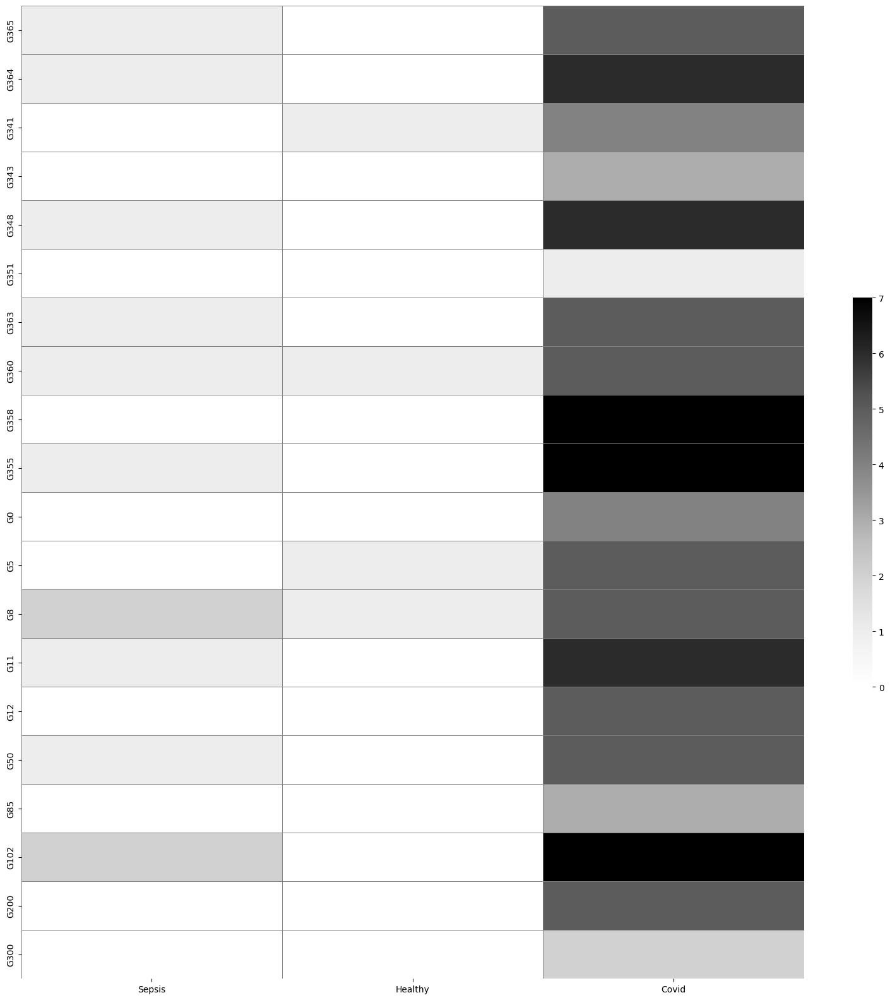

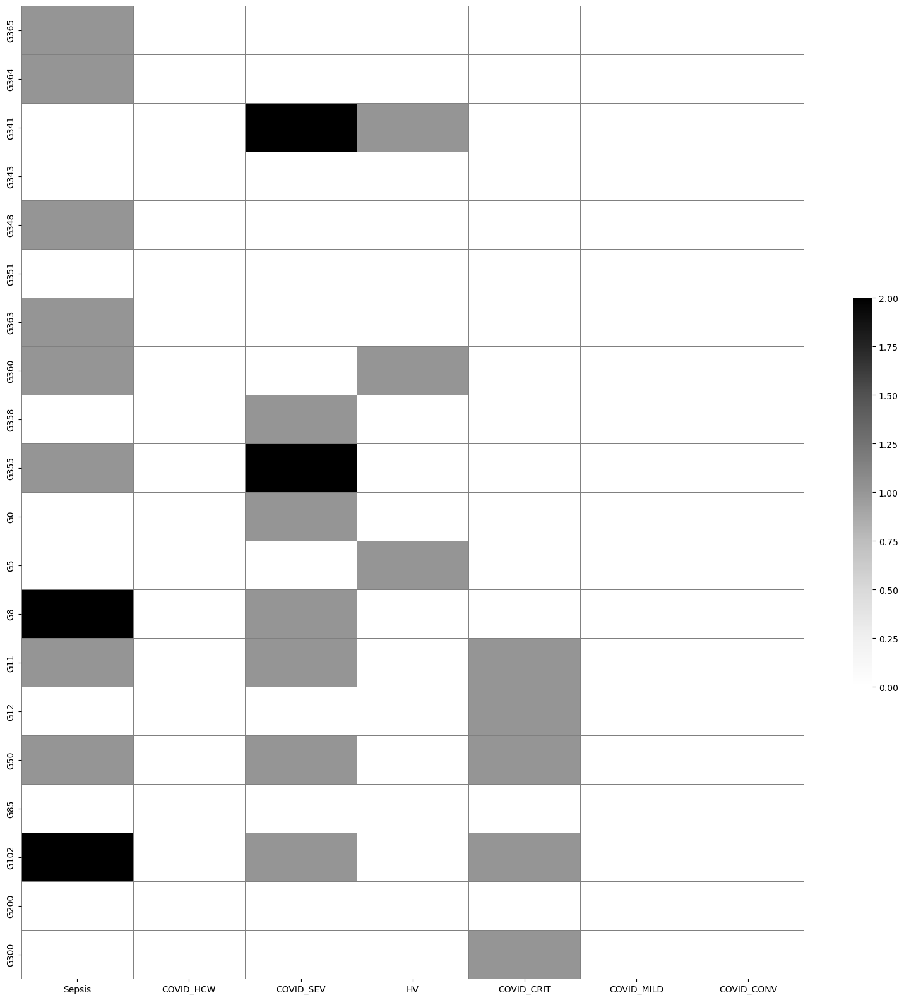

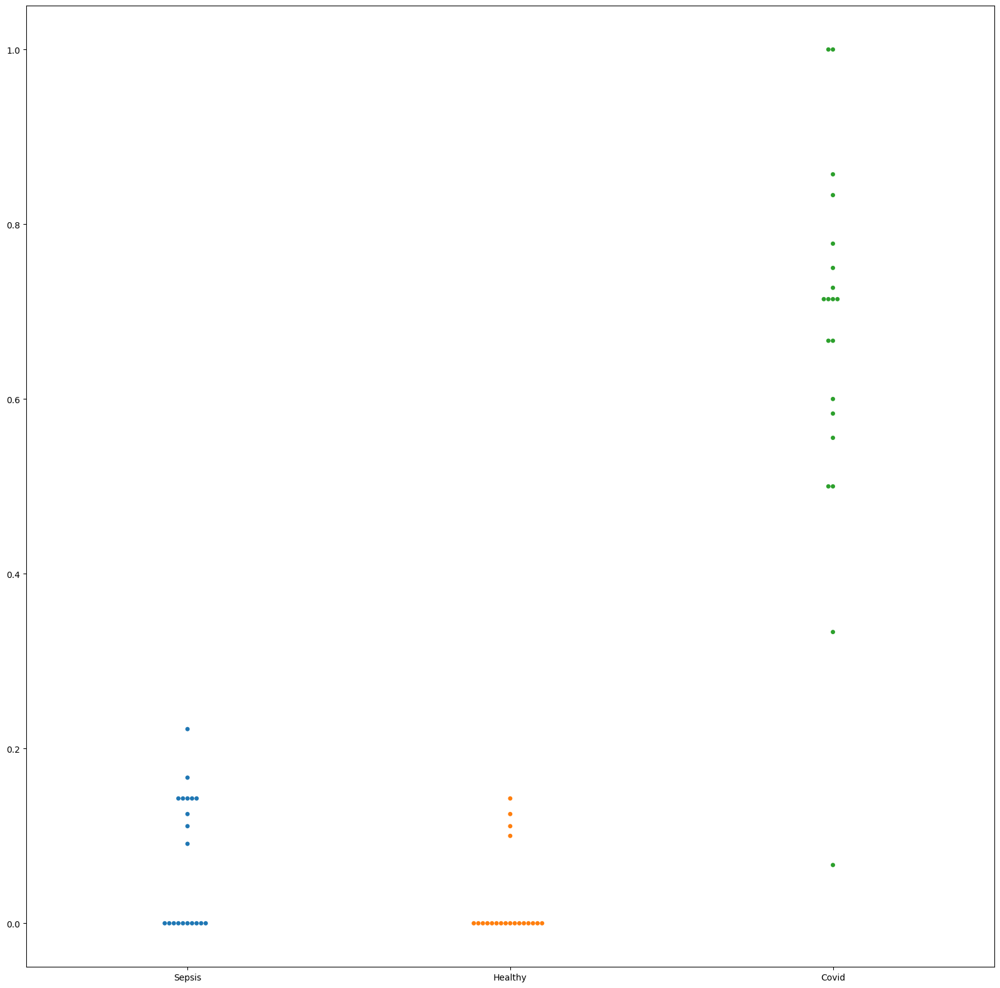

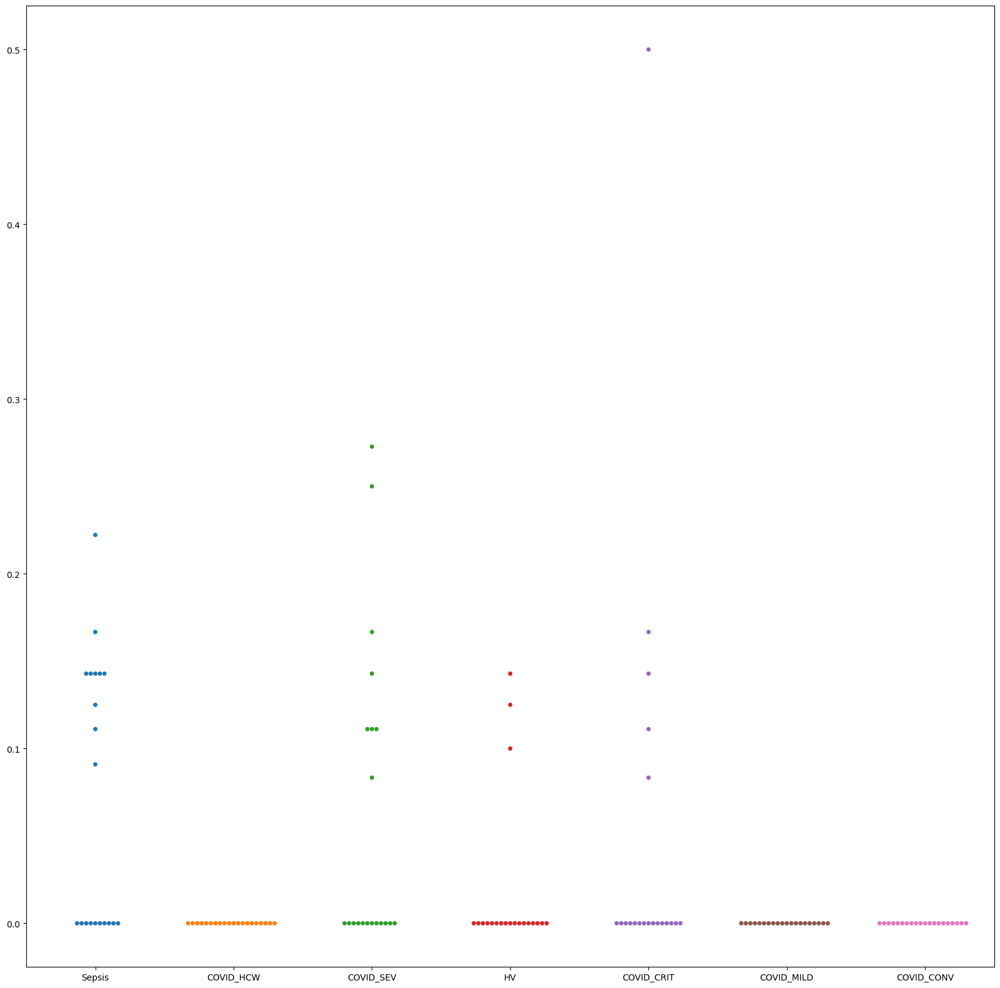

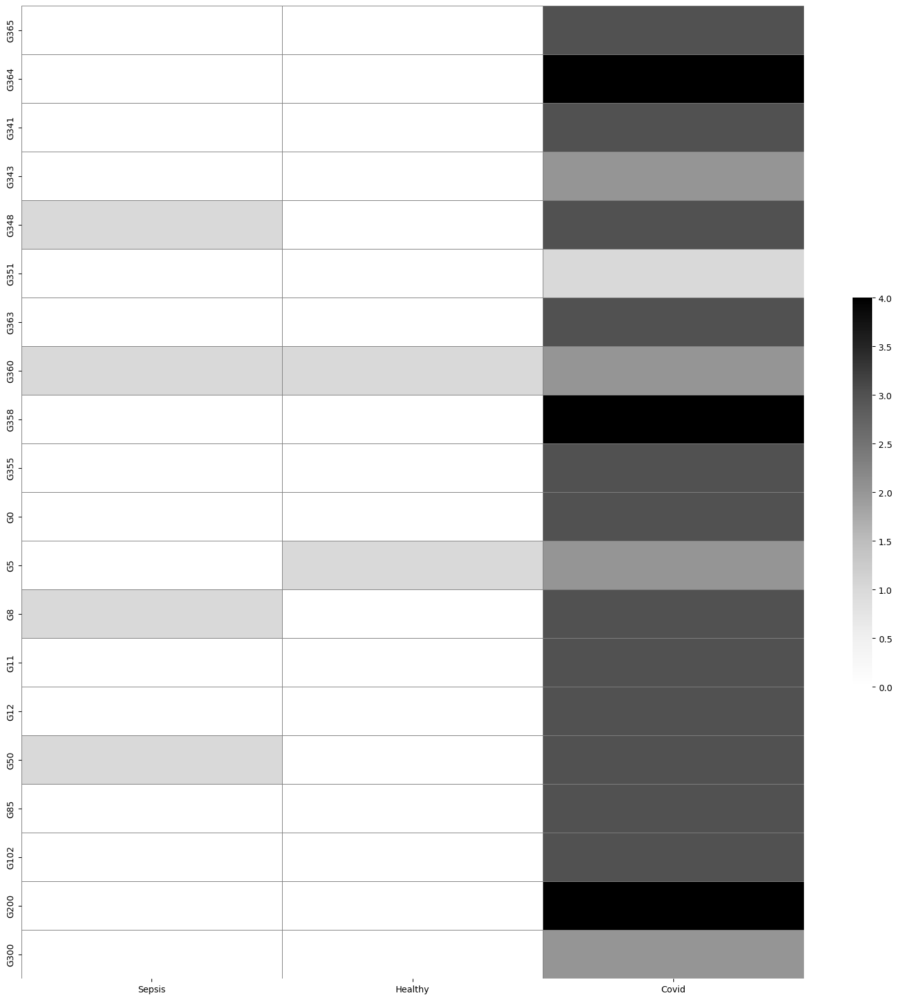

...

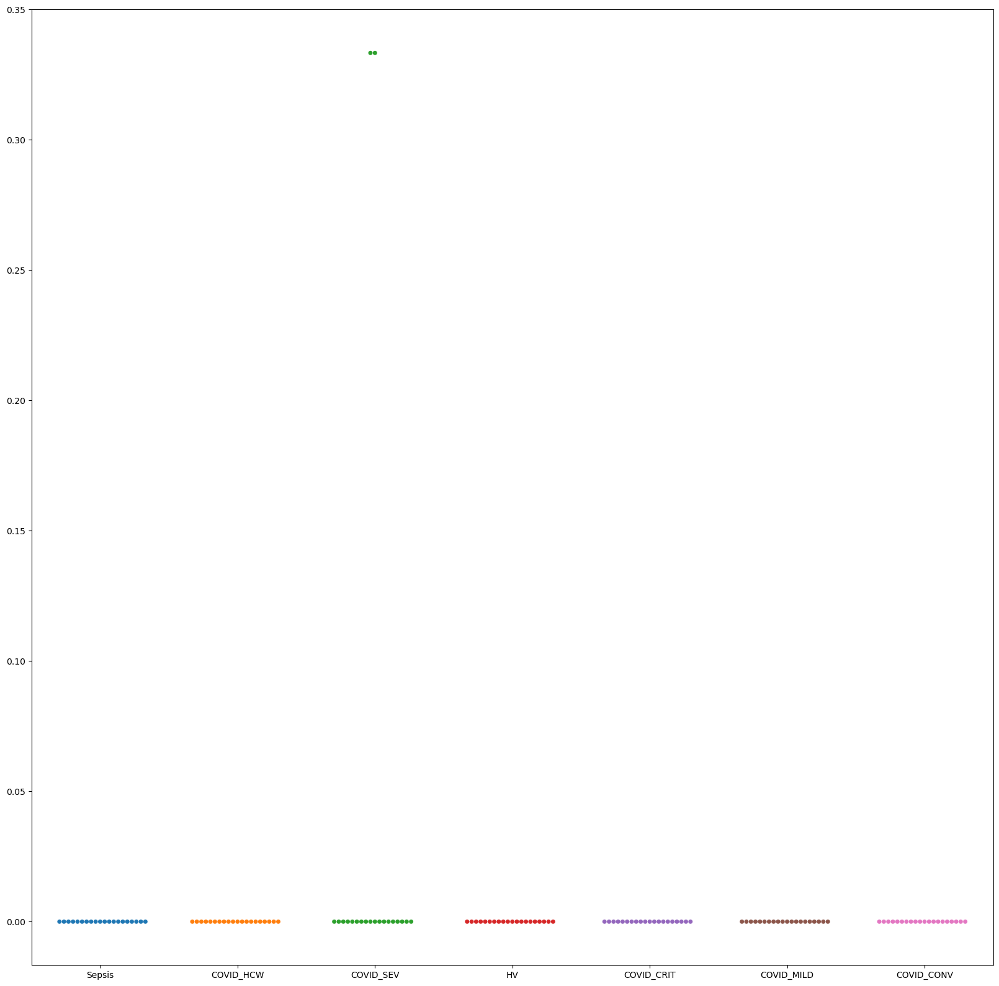

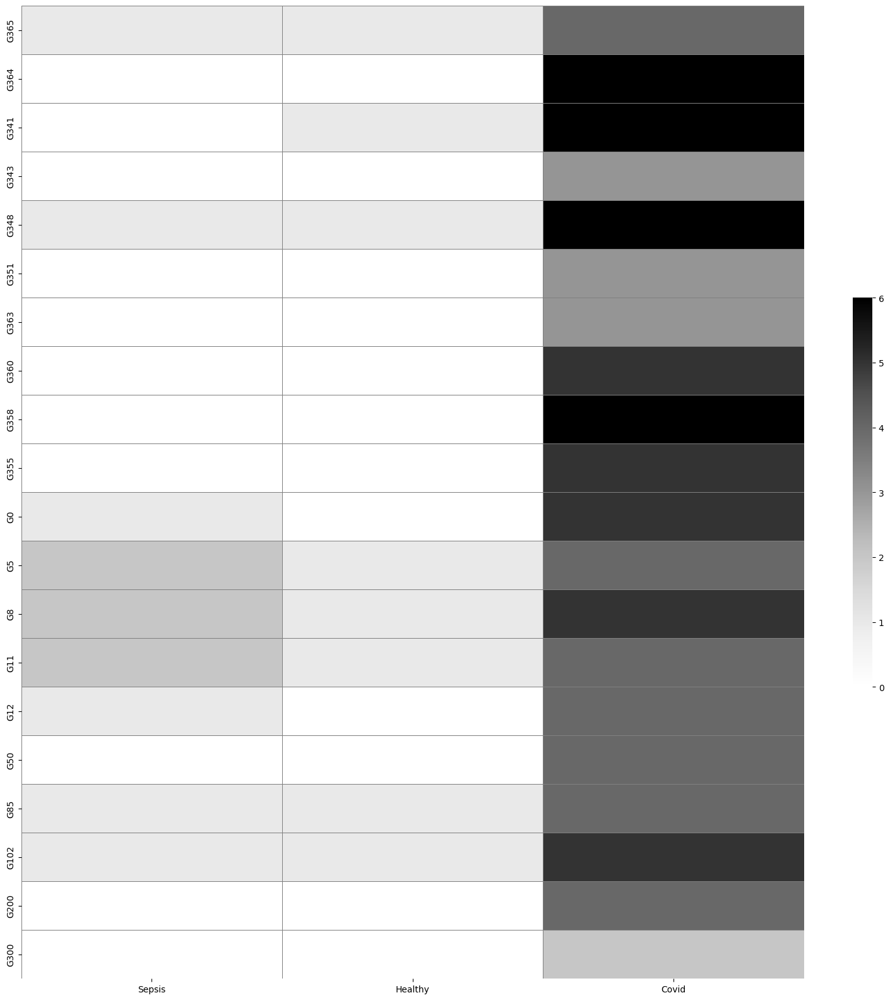

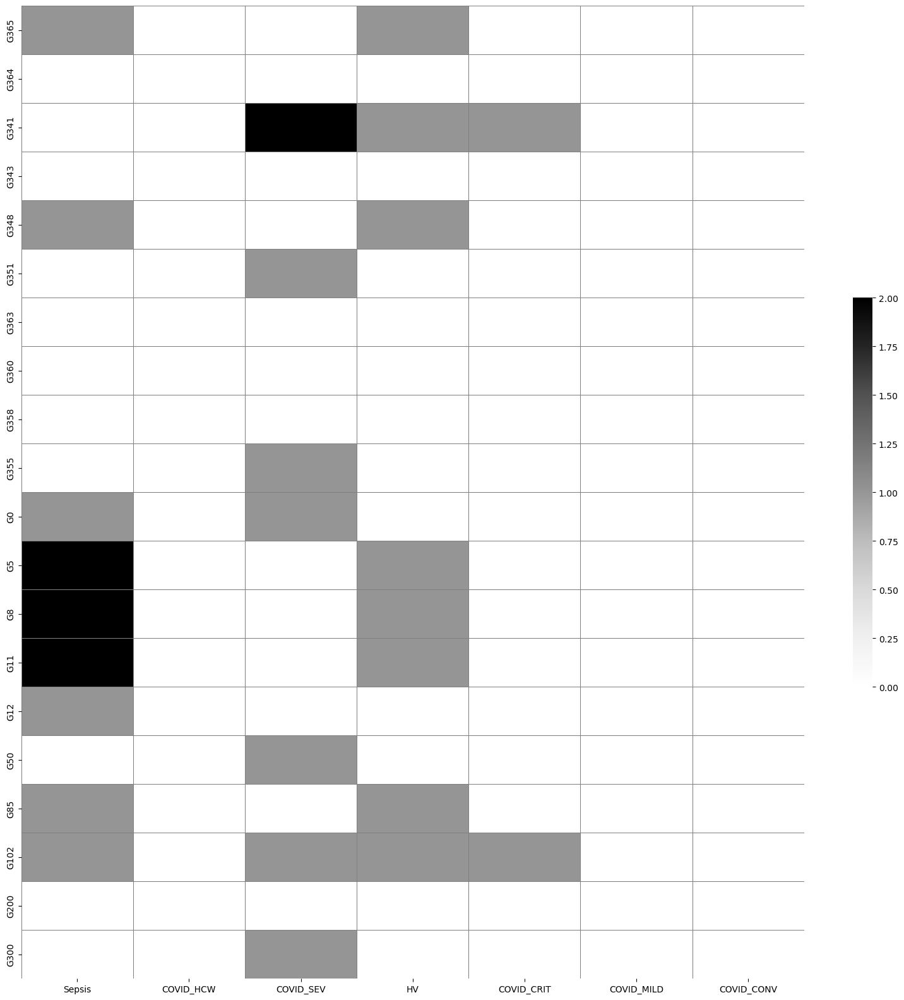

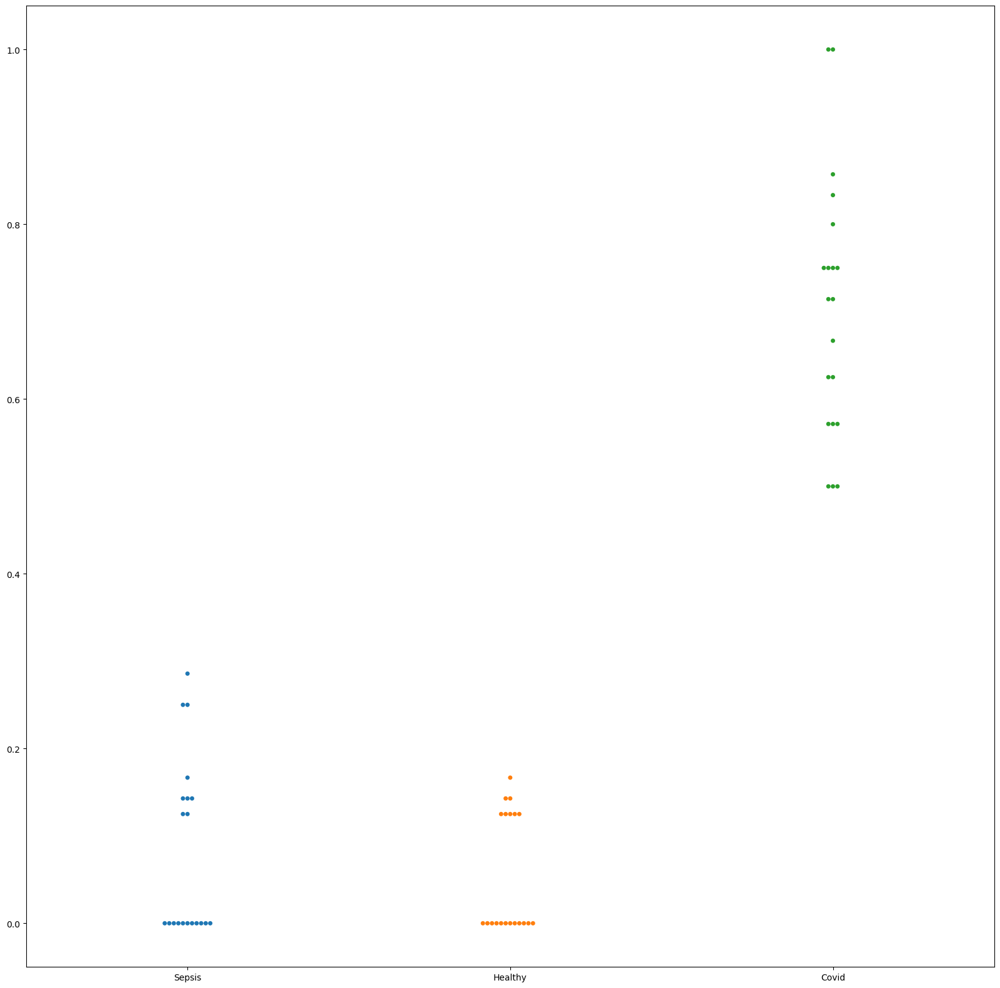

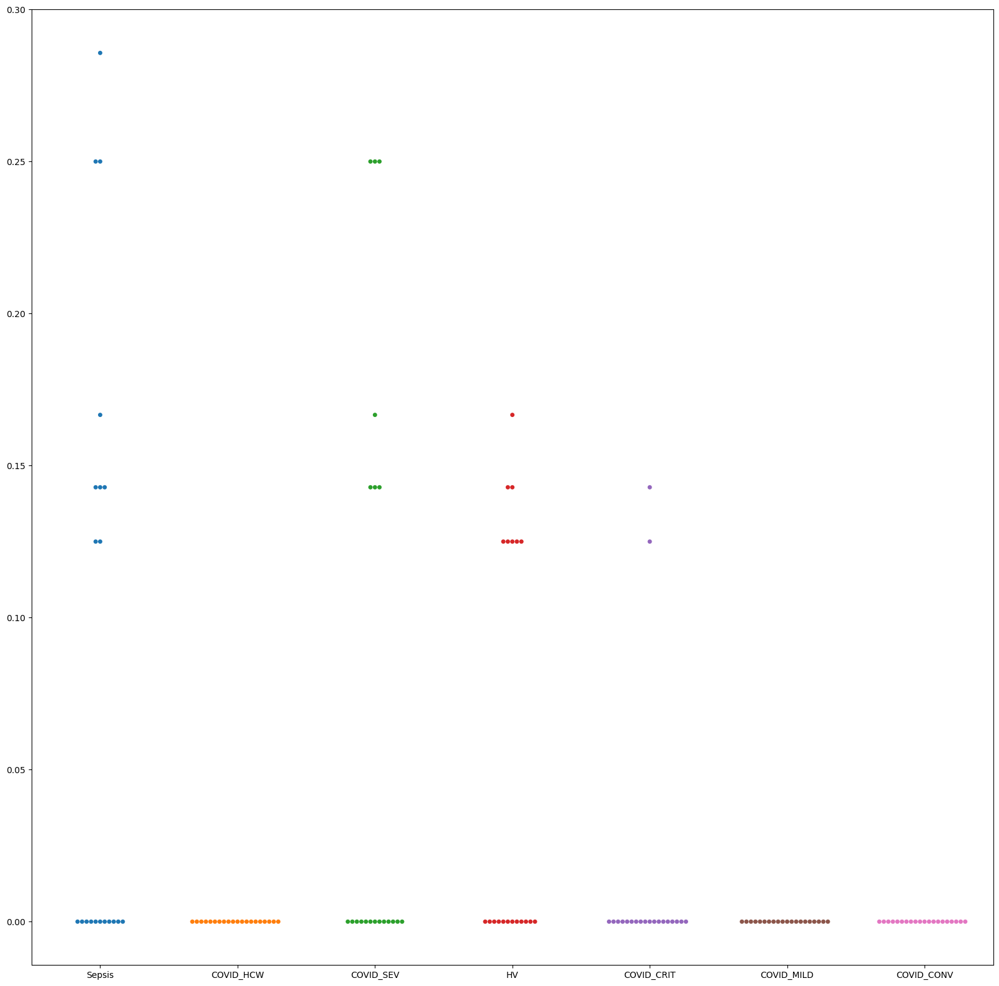

In [167]:
for graph_type, graph_type_dfs in dfs.items():
    if graph_type == "5NN":
        g = g_5NN_summary
    else:
        g = g_corr_summary
    for alg_type_name, alg_type_df in graph_type_dfs.items():
        graphs_data = g[alg_type_name]
        for graph_id, graph_data in graphs_data.items():
            alg_type_df[graph_id].append(graph_data["num_com"])
            alg_type_df[graph_id].append(graph_data["num_small_com"])

            alg_type_df[graph_id].append(graph_data["num_com_with_disease_group"]["Healthy"])
            alg_type_df[graph_id].append(graph_data["num_com_with_disease_group"]["Covid"])
            alg_type_df[graph_id].append(graph_data["num_com_with_disease_group"]["Sepsis"])

            alg_type_df[graph_id].append(graph_data["num_com_with_disease"]["Sepsis"])
            alg_type_df[graph_id].append(graph_data["num_com_with_disease"]["COVID_HCW"])
            alg_type_df[graph_id].append(graph_data["num_com_with_disease"]["COVID_SEV"])
            alg_type_df[graph_id].append(graph_data["num_com_with_disease"]["HV"])
            alg_type_df[graph_id].append(graph_data["num_com_with_disease"]["COVID_CRIT"])
            alg_type_df[graph_id].append(graph_data["num_com_with_disease"]["COVID_MILD"])
            alg_type_df[graph_id].append(graph_data["num_com_with_disease"]["COVID_CONV"])

            diseases_plots[graph_type][alg_type_name][graph_id]= list(graph_data["num_com_with_disease"].values())
            disease_groups_plots[graph_type][alg_type_name][graph_id]= list(graph_data["num_com_with_disease_group"].values())

        output_path = os.path.join(tables, graph_type+ "_"+ alg_type_name + ".csv")
        print("_____" + graph_type + "_" + alg_type_name+ "______")
        print()
        data_frame = pd.DataFrame(data= alg_type_df, index=index)
        print(data_frame)
        print()
        print("___________")
        data_frame.to_csv(output_path)

        df_d = pd.DataFrame(data= diseases_plots[graph_type][alg_type_name], index=d_index).transpose()
        df_dg = pd.DataFrame(data= disease_groups_plots[graph_type][alg_type_name], index=dg_index).transpose()

        data = {gt: [c/ g[alg_type_name][gt]["num_com"] for c in counts]  for gt, counts in diseases_plots[graph_type][alg_type_name].items()}
        df_d_pct = pd.DataFrame(data= data, index=d_index).transpose()
        data = {gt: [c/ g[alg_type_name][gt]["num_com"] for c in counts]  for gt, counts in disease_groups_plots[graph_type][alg_type_name].items()}
        df_dg_pct = pd.DataFrame(data= data, index=dg_index).transpose()

        fig_dg,ax_dg=plt.subplots(figsize=(20,20))
        sb.heatmap(df_dg, cmap ='Greys', robust = True, linewidth=.5, linecolor = "grey", cbar_kws={"shrink": 0.4}, ax= ax_dg)
        fig_dg.savefig(os.path.join( plots, "dg_" + graph_type+ "_"+ alg_type_name) )

        fig_d,ax_d=plt.subplots(figsize=(20,20))
        sb.heatmap(df_d, cmap ='Greys', robust = True, linewidth=.5, linecolor = "grey", cbar_kws={"shrink": 0.4}, ax= ax_d)
        fig_d.savefig(os.path.join(plots, "d_" + graph_type+ "_"+ alg_type_name) )
        
        fig_dg_pct,ax_dg_pct = plt.subplots(figsize=(20,20))
        sb.swarmplot(data=df_dg_pct, ax = ax_dg_pct)
        fig_dg_pct.savefig(os.path.join(plots, "dg_pct_" + graph_type+ "_"+ alg_type_name) )

        fig_d_pct,ax_d_pct = plt.subplots(figsize=(20,20))
        sb.swarmplot(data=df_d_pct,ax =  ax_d_pct)
        fig_d_pct.savefig(os.path.join(plots, "d_pct_" + graph_type+ "_"+ alg_type_name) )

In [ ]:
for graph_type, graph_type_dfs in dfs.items():
    if graph_type == "5NN":
        g = g_5NN_summary
    else:
        g = g_corr_summary

    for alg_type_name, alg_type_df in graph_type_dfs.items():
        plot_pos = {"row": 0, "col": 0}
        fig_dg, ax_dg = plt.subplots(5,4, figsize=(30,30))
        fig_d, ax_d = plt.subplots(5,4, figsize=(30,30))
        fig_dg_box, ax_dg_box = plt.subplots(5,4, figsize=(30,30))
        fig_d_box, ax_d_box = plt.subplots(5,4, figsize=(30,30))

        graphs_data = g[alg_type_name]
        for graph_id, graph_data in graphs_data.items():
            
            data_dg = {k:list(v.values()) for k, v in graph_data["com_disease_group_distr_map"].items()}
            data_d = {k:list(v.values()) for k, v in graph_data["com_disease_distr_map"].items()}

            dg_df = pd.DataFrame(data = data_dg, index = disease_groups).transpose()
            dg_df.plot(kind='bar', stacked=True, ax=ax_dg[plot_pos["row"],plot_pos["col"]], legend = False )
            ax_dg[plot_pos["row"],plot_pos["col"]].set_title(graph_id)
            if graph_id == "G0":
                # Get colours for current style
                colours = plt.rcParams['axes.prop_cycle'].by_key()['color']
                # Set up handles (the bits that are drawn in the legend) and labels
                handles = []
                group_labels = disease_groups
                for group_idx in range(len(group_labels)):
                    # Create a simple patch that is the correct colour
                    colour = colours[group_idx]
                    handles.append(Patch(edgecolor=colour, facecolor=colour, fill=True))
                # Acutally create our figure legend, using the above handles and labels
                loc='lower center'
                ncol=len(group_labels)
                fig_dg.legend(handles=handles, labels=group_labels, loc=loc, ncol=ncol)

            sb.boxplot(data=dg_df, ax = ax_dg_box[plot_pos["row"],plot_pos["col"]])
            ax_dg_box[plot_pos["row"],plot_pos["col"]].set_title(graph_id)

            d_df = pd.DataFrame(data = data_d, index = diseases).transpose()
            d_df.plot(kind='bar', stacked=True, ax=ax_d[plot_pos["row"],plot_pos["col"]], legend = False )
            ax_d[plot_pos["row"],plot_pos["col"]].set_title(graph_id)
            if graph_id == "G0":
                # Get colours for current style
                colours = plt.rcParams['axes.prop_cycle'].by_key()['color']
                # Set up handles (the bits that are drawn in the legend) and labels
                handles = []
                group_labels = diseases
                for group_idx in range(len(group_labels)):
                    # Create a simple patch that is the correct colour
                    colour = colours[group_idx]
                    handles.append(Patch(edgecolor=colour, facecolor=colour, fill=True))
                # Acutally create our figure legend, using the above handles and labels
                loc='lower center'
                ncol=len(group_labels)
                fig_d.legend(handles=handles, labels=group_labels, loc=loc, ncol=ncol)
            
            sb.boxplot(data=d_df, ax = ax_d_box[plot_pos["row"],plot_pos["col"]])
            ax_d_box[plot_pos["row"],plot_pos["col"]].set_title(graph_id)

            #update position in plot
            plot_pos["col"] += 1
            if plot_pos["col"] == 4:
                plot_pos["col"] = 0 
                plot_pos["row"] += 1


        fig_dg.savefig(os.path.join(plots, "dg_p_distr_" + graph_type+ "_"+ alg_type_name) )
        fig_d.savefig(os.path.join(plots, "d_p_distr_" + graph_type+ "_"+ alg_type_name) )
        fig_dg_box.savefig(os.path.join(plots, "dg_p_distr_box_" + graph_type+ "_"+ alg_type_name) )
        fig_d_box.savefig(os.path.join(plots, "d_p_distr_box_" + graph_type+ "_"+ alg_type_name) )

In [146]:
dist_summary_d = {"corr":{}, "5NN":{}}
for i, d1 in enumerate(diseases):
    for j in range(i, len(diseases)):
        d2 = diseases[j]
        dist_summary_d["corr"][d1+"--"+d2] = {g:80 for g in graphs_to_explore}
        dist_summary_d["5NN"][d1+"--"+d2] = {g:80 for g in graphs_to_explore}

dist_summary_dg = {"corr":{}, "5NN":{}}
for i, d1 in enumerate(disease_groups):
    for j in range(i, len(disease_groups)):
        d2 = disease_groups[j]
        dist_summary_dg["corr"][d1+"--"+d2] = {g:80 for g in graphs_to_explore}
        dist_summary_dg["5NN"][d1+"--"+d2] = {g:80 for g in graphs_to_explore}

In [153]:
for graph_id in graphs_to_explore:
    g_5NN = id_to_5NN[graph_id]
    g_corr = id_to_graph_per_node_5[graph_id]

    node_diseases = []
    node_disease_groups = []
    
    for i, v in enumerate(g_5NN.vs):
        node_diseases.append(v["disease"])
        node_disease_groups.append(v["disease_group"])

    dst_corr = np.array(g_corr.distances(source=g_corr.vs, target=g_corr.vs, weights=None, mode='all')).reshape(len(g_corr.vs), -1) 
    dst_5NN = np.array(g_5NN.distances(source=g_5NN.vs, target=g_5NN.vs, weights=None, mode='all')).reshape(len(g_5NN.vs), -1) 

    df_corr_d = pd.DataFrame(dst_corr, columns = node_diseases, index = node_diseases)
    df_corr_d.sort_index(inplace = True) # Sort the row names
    df_corr_d.sort_index(inplace = True, axis = 1) # Sort the column names
    
    df_corr_dg = pd.DataFrame(dst_corr, columns = node_disease_groups, index = node_disease_groups)
    df_corr_dg.sort_index(inplace = True) # Sort the row names
    df_corr_dg.sort_index(inplace = True, axis = 1) # Sort the column names


    df_5NN_d = pd.DataFrame(dst_5NN, columns = node_diseases, index = node_diseases)
    df_5NN_d.sort_index(inplace = True) # Sort the row names
    df_5NN_d.sort_index(inplace = True, axis = 1) # Sort the column names

    df_5NN_dg = pd.DataFrame(dst_5NN, columns = node_disease_groups, index = node_disease_groups)
    df_5NN_dg.sort_index(inplace = True) # Sort the row names
    df_5NN_dg.sort_index(inplace = True, axis = 1) # Sort the column names


    for i, d1 in enumerate(df_corr_d.columns.unique()):
        for j in range(i, len(df_corr_d.columns.unique())):
            d2 = df_corr_d.columns.unique()[j]
            key = d1+"--"+d2
            if key not in dist_summary_d["corr"].keys():
                key = d2+"--"+d1
            avg_dist_corr_d = df_corr_d.loc[d1, d2].mean().mean()
            avg_dist_5NN_d = df_5NN_d.loc[d1, d2].mean().mean()
            dist_summary_d["corr"][key][graph_id]= avg_dist_corr_d
            dist_summary_d["5NN"][key][graph_id]= avg_dist_5NN_d
            avg_dist_corr_d = 80
            avg_dist_5NN_d = 80


    for i, d1 in enumerate(df_corr_dg.columns.unique()):
        for j in range(i, len(df_corr_dg.columns.unique())):
            d2 = df_corr_dg.columns.unique()[j]
            key = d1+"--"+d2
            if key not in dist_summary_d["corr"].keys():
                key = d2+"--"+d1
            avg_dist_corr_dg = df_corr_dg.loc[d1, d2].mean().mean()
            avg_dist_5NN_dg = df_5NN_dg.loc[d1, d2].mean().mean()
            dist_summary_dg["corr"][key][graph_id]= avg_dist_corr_dg
            dist_summary_dg["5NN"][key][graph_id]= avg_dist_5NN_dg
            avg_dist_corr_dg = 80
            avg_dist_5NN_dg = 80

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0


In [132]:
d_corr_dist_summary_data = {g:[] for g in graphs_to_explore}
d_5NN_dist_summary_data = {g:[] for g in graphs_to_explore}
dg_corr_dist_summary_data = {g:[] for g in graphs_to_explore}
dg_5NN_dist_summary_data = {g:[] for g in graphs_to_explore}
index_d = dist_summary_d["corr"].keys()
index_dg = dist_summary_dg["corr"].keys()

In [133]:
for k,v in dist_summary_dg["corr"].items():
    for g, dist in v.items():
        dg_corr_dist_summary_data[g].append(dist)

for k,v in dist_summary_dg["5NN"].items():
    for g, dist in v.items():
        dg_5NN_dist_summary_data[g].append(dist)

for k,v in dist_summary_d["corr"].items():
    for g, dist in v.items():
        d_corr_dist_summary_data[g].append(dist)

for k,v in dist_summary_d["5NN"].items():
    for g, dist in v.items():
        d_5NN_dist_summary_data[g].append(dist)



d_corr_dist_summary_df = pd.DataFrame(d_corr_dist_summary_data, index = index_d)
d_5NN_dist_summary_df = pd.DataFrame(d_5NN_dist_summary_data, index = index_d)
dg_corr_dist_summary_df = pd.DataFrame(dg_corr_dist_summary_data, index = index_dg)
dg_5NN_dist_summary_df = pd.DataFrame(dg_5NN_dist_summary_data, index = index_dg)

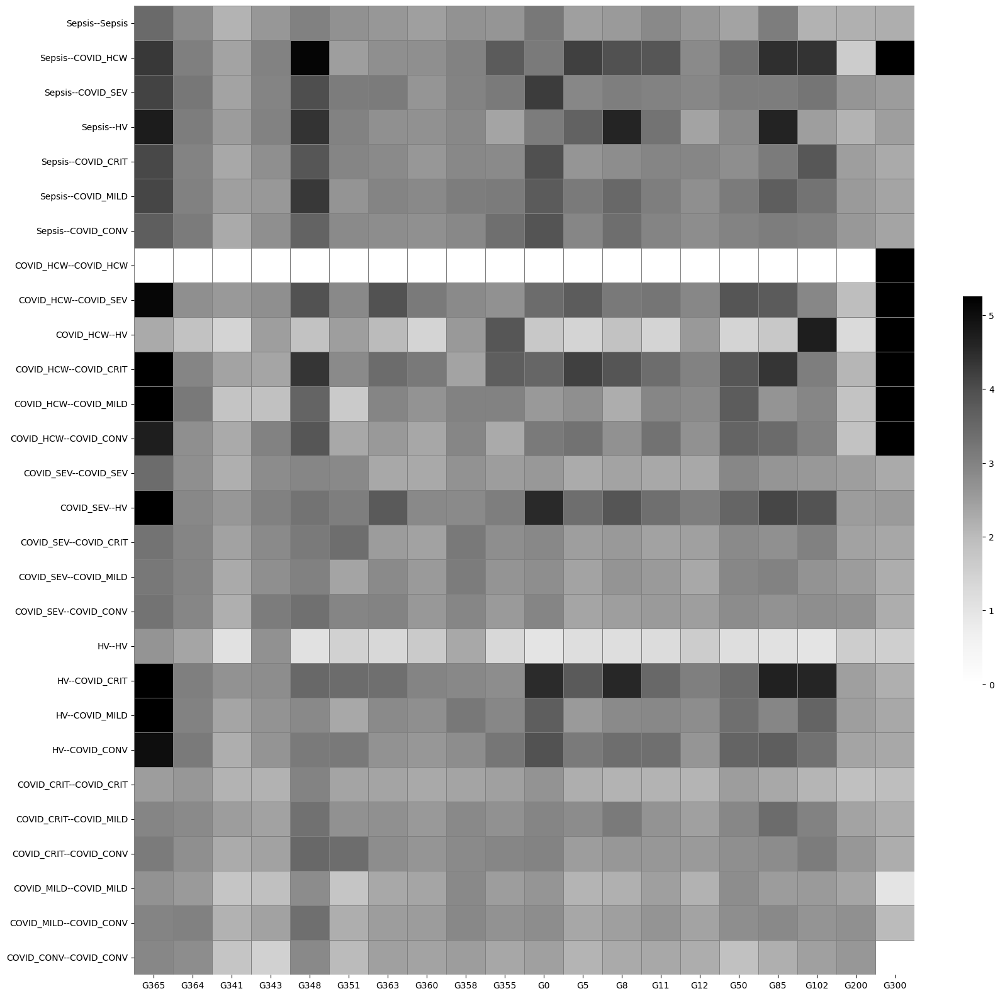

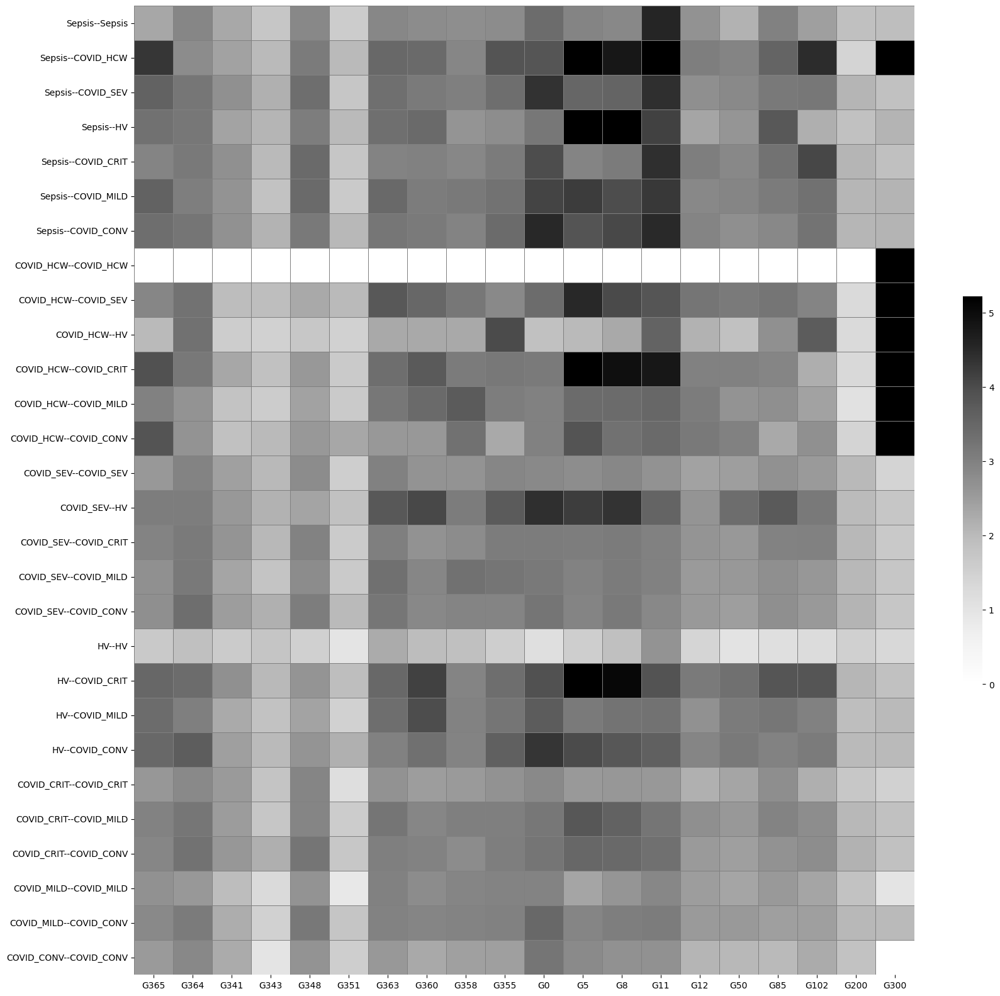

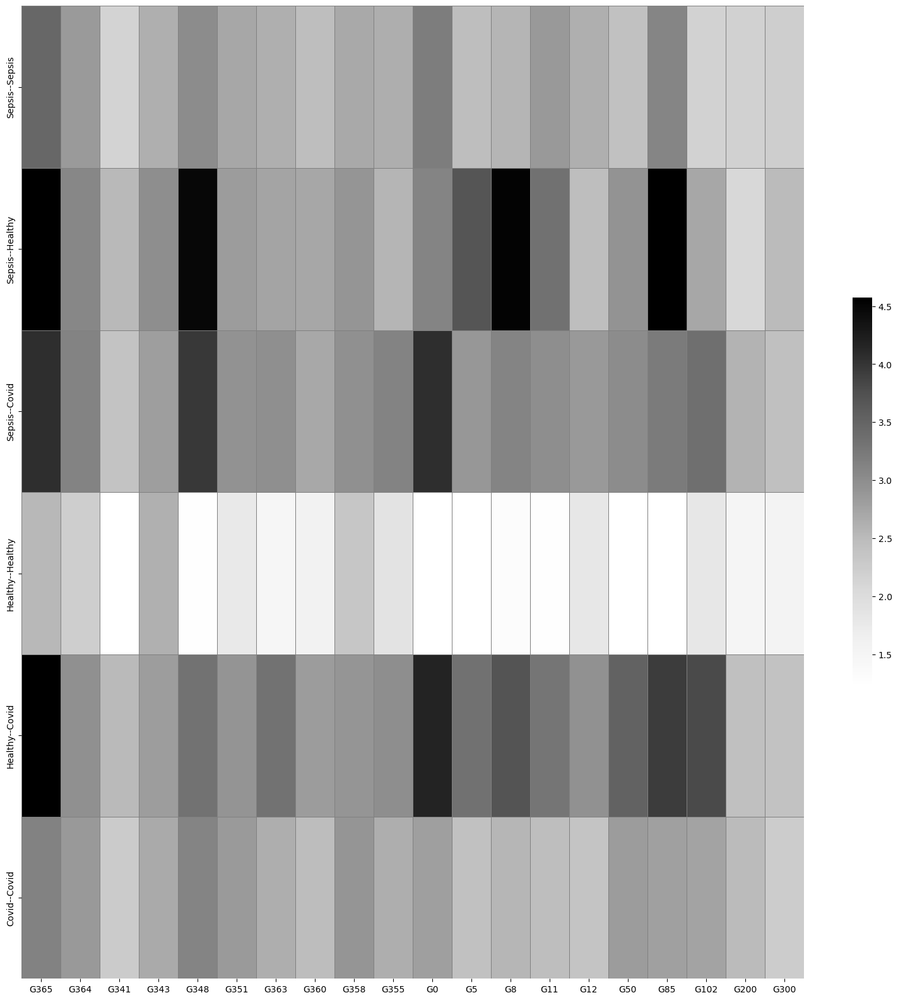

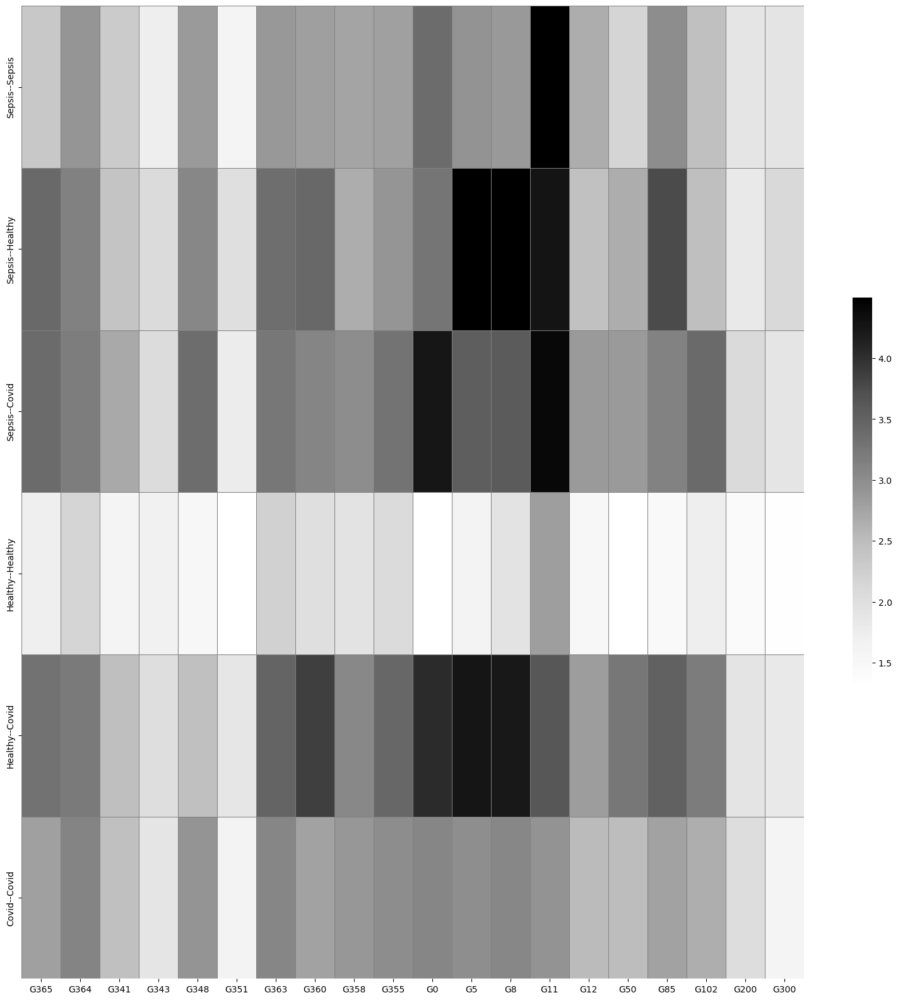

In [134]:
fig,ax=plt.subplots(figsize=(20,20))
sb.heatmap(d_corr_dist_summary_df, cmap ='Greys', robust = True, linewidth=.5, linecolor = "grey", cbar_kws={"shrink": 0.4}, ax= ax)
fig.savefig(os.path.join(plots, "dist_d_corr") )

fig,ax=plt.subplots(figsize=(20,20))
sb.heatmap(d_5NN_dist_summary_df, cmap ='Greys', robust = True, linewidth=.5, linecolor = "grey", cbar_kws={"shrink": 0.4}, ax= ax)
fig.savefig(os.path.join(plots, "dist_d_5nn") )

fig,ax=plt.subplots(figsize=(20,20))
sb.heatmap(dg_corr_dist_summary_df, cmap ='Greys', robust = True, linewidth=.5, linecolor = "grey", cbar_kws={"shrink": 0.4}, ax= ax)
fig.savefig(os.path.join(plots, "dist_dg_corr") )

fig,ax=plt.subplots(figsize=(20,20))
sb.heatmap(dg_5NN_dist_summary_df, cmap ='Greys', robust = True, linewidth=.5, linecolor = "grey", cbar_kws={"shrink": 0.4}, ax= ax)
fig.savefig(os.path.join(plots, "dist_dg_5NN") )